<a href="https://colab.research.google.com/github/Saibhossain/face-generation-model/blob/main/Gan_face_generator_internship.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# learn pytorch

It designed to simplify the process of building neural networks and machine learning models. With its dynamic computation graph, PyTorch allows developers to modify the network’s behavior in real-time, making it an excellent choice for both beginners and researchers.

## torch operation

In [ ]:
!pip install torch torchvision

In [ ]:
# A tensor is a multi-dimensional array that is the fundamental data structure used in PyTorch
import torch

tensor_1d = torch.tensor([1,2,3,4,5,6,7,8,9,10])
print("1D tensor vector", tensor_1d)
t2 = torch.tensor([[1,2,3,4,5],[6,7,8,9,10]])
print("2D tensor vector", t2)

round = torch.rand(2,3)
print("random tensor", round)

1D tensor vector tensor([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10])
2D tensor vector tensor([[ 1,  2,  3,  4,  5],
        [ 6,  7,  8,  9, 10]])
random tensor tensor([[0.4253, 0.8035, 0.6287],
        [0.0829, 0.0149, 0.8095]])


In [ ]:
# torch (indexing, slicing, Reshaping)
import torch
tensor = torch.tensor([[1,2],[3,4],[5,6]])
element = tensor[1,0]
print("tensor=",tensor,"\nelement=",element)

slice_tensor = tensor[:2,:]
print("slice_tensor",slice_tensor)

tensor= tensor([[1, 2],
        [3, 4],
        [5, 6]]) 
element= tensor(3)
slice_tensor tensor([[1, 2],
        [3, 4]])


In [ ]:
# tensor broadcasting and matrix multiplication
import torch

a = torch.tensor([[1,2,3],[4,5,6]])
b = torch.tensor([[10,20,30]])

broadcst= a +b
print("a + b = broadcast\n",a ," + ", b,"==", broadcst)

multipication = torch.matmul(a,b.T)
print("multipication = ",multipication)

a + b = broadcast
 tensor([[1, 2, 3],
        [4, 5, 6]])  +  tensor([[10, 20, 30]]) == tensor([[11, 22, 33],
        [14, 25, 36]])
multipication=  tensor([[140],
        [320]])


In [ ]:
# GPU acceleration
import torch
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)
torch_size = (10000,10000)
a = torch.randn(torch_size, device=device)
b = torch.randn(torch_size, device=device)
c= a+b
print("CPU", c.cpu().shape)
print("allocate", torch.cuda.memory_allocated(device=device)/(1024**3),"GB")
print("cached", torch.cuda.memory_reserved(device=device)/(1024**2),"MB")

cpu
CPU torch.Size([10000, 10000])
allocate 0.0 GB
cached 0.0 MB


In [ ]:
# define the Neural Network
import torch
import torch.nn as nn

class SimpleNN(nn.Module):
  def __init__(self):
    super(SimpleNN, self).__init__()
    self.fc1 = nn.Linear(2,4)
    self.fc2 = nn.Linear(4,1)

  def forward(self,x):
    x = torch.relu(self.fc1(x))
    x = self.fc2(x)
    return x

model = SimpleNN()
print(model)

SimpleNN(
  (fc1): Linear(in_features=2, out_features=4, bias=True)
  (fc2): Linear(in_features=4, out_features=1, bias=True)
)


In [ ]:
# sample data
X_train = torch.tensor([[0.0, 0.0], [0.0, 1.0], [1.0, 0.0], [1.0, 1.0]])
y_train = torch.tensor([[0.0], [1.0], [1.0], [0.0]])

# Instantiate the Model, Loss Function, and Optimizer
import torch.optim as optim

model = SimpleNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001) # Fix: Instantiate Adam optimizer

# training loop

for epoch in range(100):
  model.train()

  outputs = model(X_train)
  loss = criterion(outputs, y_train)

  optimizer.zero_grad()
  loss.backward()
  optimizer.step()

  if (epoch + 1) % 10 == 0:
        print(f'Epoch [{epoch + 1}/100], Loss: {loss.item():.4f}')

Epoch [10/100], Loss: 0.3154
Epoch [20/100], Loss: 0.2997
Epoch [30/100], Loss: 0.2858
Epoch [40/100], Loss: 0.2738
Epoch [50/100], Loss: 0.2636
Epoch [60/100], Loss: 0.2549
Epoch [70/100], Loss: 0.2476
Epoch [80/100], Loss: 0.2417
Epoch [90/100], Loss: 0.2368
Epoch [100/100], Loss: 0.2329


In [ ]:
model.eval()
with torch.no_grad():
    test_data = torch.tensor([[0.0, 0.0], [0.0, 1.0], [1.0, 0.0], [1.0, 1.0]])
    predictions = model(test_data)
    print(f'Predictions:\n{predictions}')

Predictions:
tensor([[0.4812],
        [0.5147],
        [0.4286],
        [0.3698]])


## COnvTransposse2d


In [ ]:
import torch
import torch.nn as nn

noiso = torch.randn(1,100,1,1) # Input: Batch of 1, 100 channels (noise), 1x1 pixel size
layer = nn.ConvTranspose2d(100,256,4,1,0,bias=False) # Layer: Input 100, Output 256, Kernel 4, Stride 1

output = layer(noiso)
print(output.shape)

torch.Size([1, 256, 4, 4])


### Old Vanilla Generator

In [ ]:
class VanillaGenerator(nn.Module):
    def __init__(self):
        # Simple Fully Connected Layers
        self.model = nn.Sequential(
            nn.Linear(100, 256),
            nn.ReLU(),
            nn.Linear(256, 512),
            nn.ReLU(),
            nn.Linear(512, 784), # Flattens the image
            nn.Tanh()
        )

### New DCGAN Generator

In [ ]:
class DCGANGenerator(nn.Module):
    def __init__(self):
        # Convolutional Upsampling Layers
        self.model = nn.Sequential(
            # Input: Noise Z
            # logic: ConvTranspose2d(input_channels, output_channels, kernel_size, stride, padding)

            # Layer 1: Grow to 4x4
            nn.ConvTranspose2d(100, 512, 4, 1, 0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            # Layer 2: Grow to 8x8
            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            # ... (More layers to reach 64x64) ...

            # Output Layer
            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            nn.Tanh() # Output is 3 channels (RGB), size 64x64
        )

# simple GAN for generate digit

In [ ]:
!pip install pytorch-lightning

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 831.6/831.6 kB 13.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.2/983.2 kB 38.8 MB/s eta 0:00:00


In [ ]:
import os
import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, random_split
from torchvision.datasets import MNIST

import matplotlib.pyplot as plt
import numpy as np
import pytorch_lightning as pl

random_seed = 42
torch.manual_seed(random_seed)

BATCH_SIZE= 128
AVAIL_GPUS = min(1, torch.cuda.device_count())
NUM_WORKERS=int(os.cpu_count() / 2)

class MNISTDataModule(pl.LightningDataModule):
    def __init__(self, data_dir='./', batch_size=BATCH_SIZE, num_workers=NUM_WORKERS):
      super().__init__()
      self.data_dir = data_dir
      self.batch_size = batch_size
      self.num_workers = num_workers

      self.transform = transforms.Compose(
          [
              transforms.ToTensor(),
              transforms.Normalize((0.1307,),(0.3081,)),
          ]
      )
    def prepare_data(self):
      MNIST(self.data_dir, train=True, download=True)
      MNIST(self.data_dir, train=False, download=True)

    def setup(self, stage=None):
      if stage == 'fit' or stage is None:
        mnist_full = MNIST(self.data_dir, train=True, transform=self.transform)
        self.mnist_train, self.mnist_val = random_split(mnist_full, [55000,5000])

        if stage == 'test' or stage is None:
          self.mnist_test = MNIST(self.data_dir, train=False, transform=self.transform)

    def train_dataloader(self):
      return DataLoader(self.mnist_train, batch_size=self.batch_size, num_workers=self.num_workers)
    def val_dataloader(self):
      return DataLoader(self.mnist_val, batch_size=self.batch_size, num_workers=self.num_workers)
    def test_dataloader(self):
      return DataLoader(self.mnist_test, batch_size=self.batch_size, num_workers=self.num_workers)



class Discriminator(nn.Module):
    def __init__(self):
       super().__init__()
       self.conv1 = nn.Conv2d(1,10,kernel_size=5)
       self.conv2 = nn.Conv2d(10,20,kernel_size=5)
       self.conv2_drop = nn.Dropout2d()
       self.fc1 = nn.Linear(320,50)
       self.fc2 = nn.Linear(50,1)

    def forward(self, x):
      x = F.relu(F.max_pool2d(self.conv1(x),2))
      x = F.relu(F.max_pool2d(self.conv2_drop(self.conv2(x)),2))
      x = x.view(-1,320)
      x = F.relu(self.fc1(x))
      x = F.dropout(x, training=self.training)
      x = self.fc2(x)
      return torch.sigmoid(x)


class Generator(nn.Module):
    def __init__(self, latent_dim):
       super().__init__()
       self.lin1 = nn.Linear(latent_dim,7*7*64)
       self.ct1 = nn.ConvTranspose2d(64,32,4,stride=2, padding=1)
       self.ct2 = nn.ConvTranspose2d(32,16,4,stride=2, padding=1)
       self.conv= nn.Conv2d(16,1,kernel_size=7, padding=3) # Add padding to make output 28x28

    def forward(self, x):
        # Pass latent space input into linear layer and reshape
        x = self.lin1(x)
        x = F.relu(x)
        x = x.view(-1, 64, 7, 7)  #256

        # Upsample (transposed conv) 16x16 (64 feature maps)
        x = self.ct1(x)
        x = F.relu(x)

        # Upsample to 34x34 (16 feature maps)
        x = self.ct2(x)
        x = F.relu(x)

        # Convolution to 28x28 (1 feature map)
        return self.conv(x)


class GAN(pl.LightningModule):
    def __init__(self, latent_dim=100, lr=0.0002):
      super().__init__()
      self.save_hyperparameters()
      self.generator = Generator(latent_dim=self.hparams.latent_dim)
      self.discriminator = Discriminator()

      self.validation_z = torch.randn(6, self.hparams.latent_dim) # random noise
      self.automatic_optimization = False # Set to False for manual optimization

    def forward(self, z):
      return self.generator(z)

    def adversarial_loss(self, y_hat, y):
      return F.binary_cross_entropy(y_hat,y)

    def training_step(self, batch, batch_idx):
      # Manual optimization: get optimizers
      opt_g, opt_d = self.optimizers()

      real_imgs, _ = batch

      # sample noise
      z = torch.randn(real_imgs.shape[0], self.hparams.latent_dim)
      z = z.type_as(real_imgs)

      # train generator max log(D(G(z)))
      opt_g.zero_grad()
      fake_imgs = self(z)
      y_hat = self.discriminator(fake_imgs)
      y = torch.ones(real_imgs.size(0),1)
      y = y.type_as(real_imgs)
      g_loss = self.adversarial_loss(y_hat,y)
      self.manual_backward(g_loss) # Use manual_backward for manual optimization
      opt_g.step()

      # train Discriminator max log(Dx) + log(1-D(G(z)))
      opt_d.zero_grad()
      y_hat_real = self.discriminator(real_imgs)
      y_real = torch.ones(real_imgs.size(0),1)
      y_real = y_real.type_as(real_imgs)
      real_loss = self.adversarial_loss(y_hat_real,y_real)

      y_hat_fake = self.discriminator(self(z).detach()) # detach to prevent generator from being updated twice
      y_fake = torch.zeros(real_imgs.size(0),1)
      y_fake = y_fake.type_as(real_imgs)
      fake_loss = self.adversarial_loss(y_hat_fake,y_fake)
      d_loss = (real_loss + fake_loss) / 2
      self.manual_backward(d_loss) # Use manual_backward for manual optimization
      opt_d.step()

      # Log losses (optional, for monitoring)
      self.log('g_loss', g_loss, prog_bar=True)
      self.log('d_loss', d_loss, prog_bar=True)


    def configure_optimizers(self):
      lr = self.hparams.lr
      opt_g = optim.Adam(self.generator.parameters(), lr=lr)
      opt_d = optim.Adam(self.discriminator.parameters(), lr=lr)
      return [opt_g, opt_d],[]

    def plot_imgs(self):
      z = self.validation_z.type_as(self.generator.lin1.weight)
      sample_imgs = self(z).cpu()

      print('epoch',self.current_epoch)
      fig = plt.figure()
      for i in range(sample_imgs.size(0)):
        plt.subplot(2,3,i+1)
        plt.tight_layout()
        plt.imshow(sample_imgs.detach().numpy()[i,0,:,:], cmap='gray_r', interpolation='none')
        plt.title("Generated Data")
        plt.xticks([])
        plt.yticks([])
        plt.axis('off')
      plt.show()

    def on_train_epoch_end(self):
      self.plot_imgs()

epoch 0


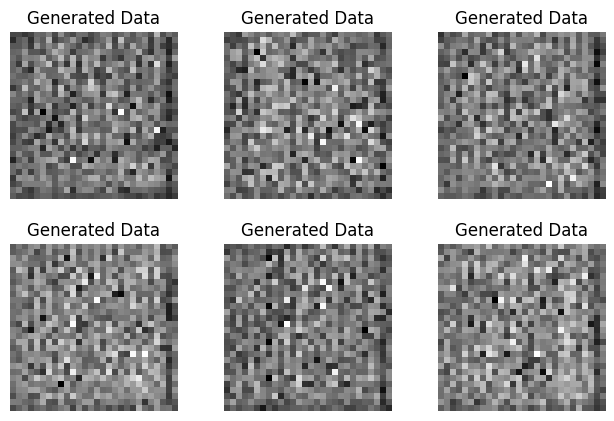

In [ ]:
dm = MNISTDataModule()
model = GAN()
model.plot_imgs()

INFO:pytorch_lightning.utilities.rank_zero:💡 Tip: For seamless cloud uploads and versioning, try installing [litmodels](https://pypi.org/project/litmodels/) to enable LitModelCheckpoint, which syncs automatically with the Lightning model registry.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name          | Type          | Params | Mode 
--------------------------------------------------------
0 | generator     | Generator     | 358 K  | train
1 | discriminator | Discriminator | 21.4 K | train
--------------------------------------------------------
379 K     Trainable params
0         Non-trainable params
379 K     Total params
1.520     Total estimated model params size (MB)
11        Modules in train mode
0         Modules in eval 

Training: |          | 0/? [00:00<?, ?it/s]

epoch 0


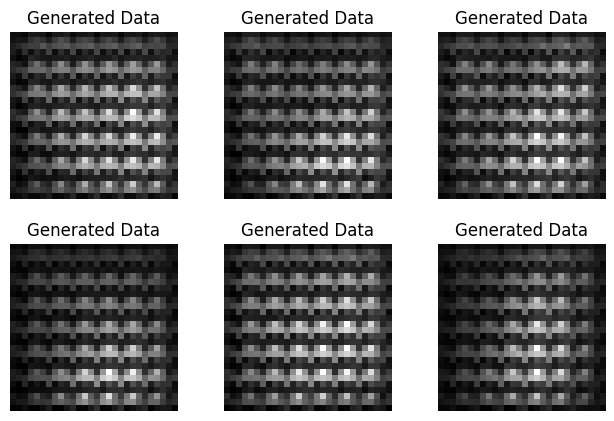

epoch 1


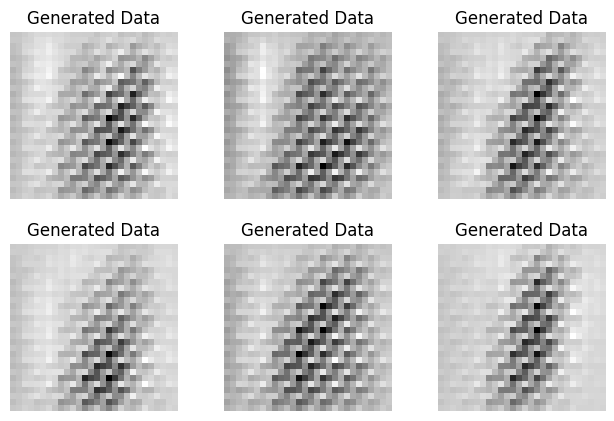

epoch 2


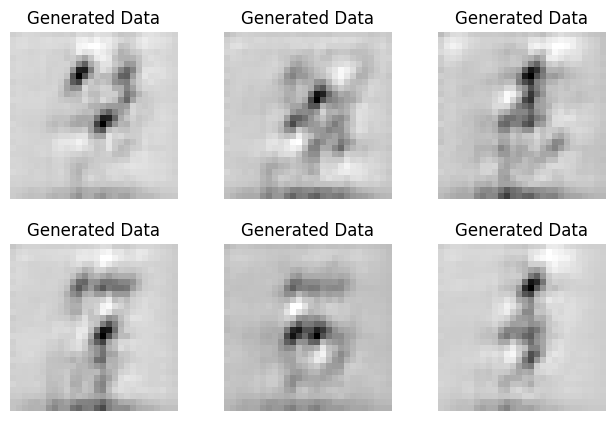

epoch 3


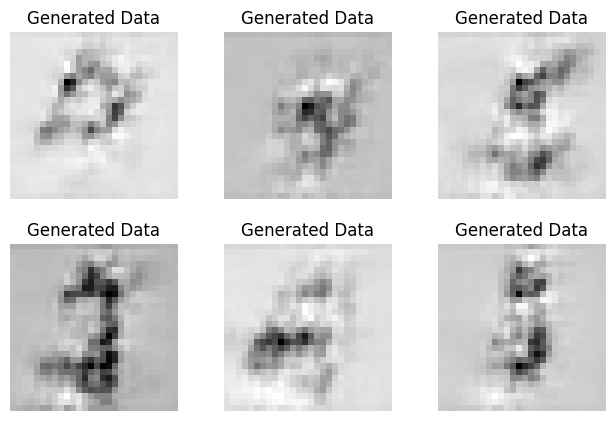

epoch 4


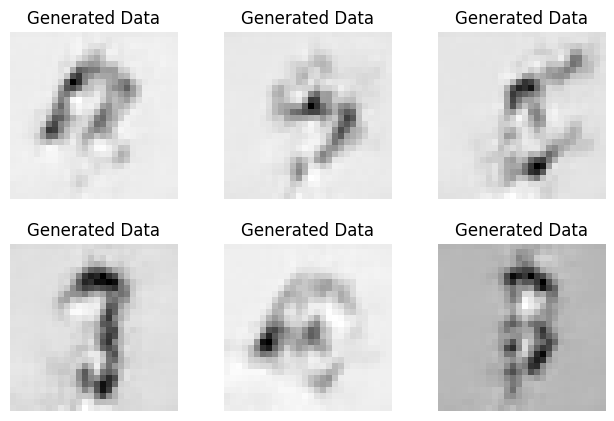

epoch 5


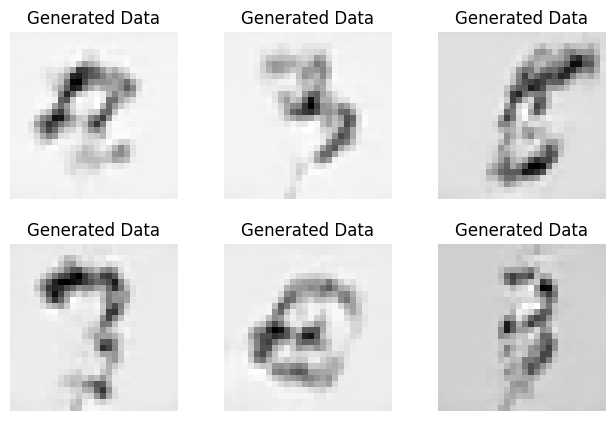

epoch 6


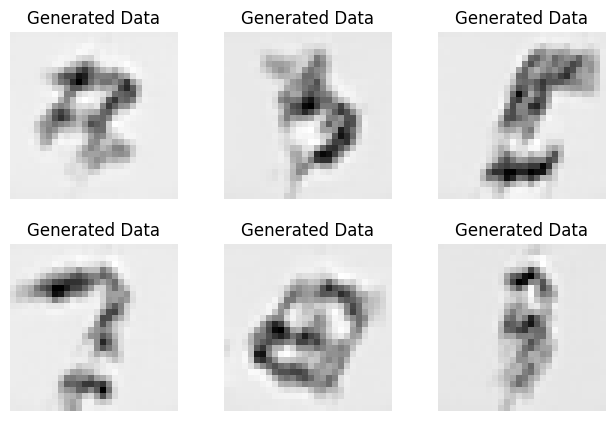

epoch 7


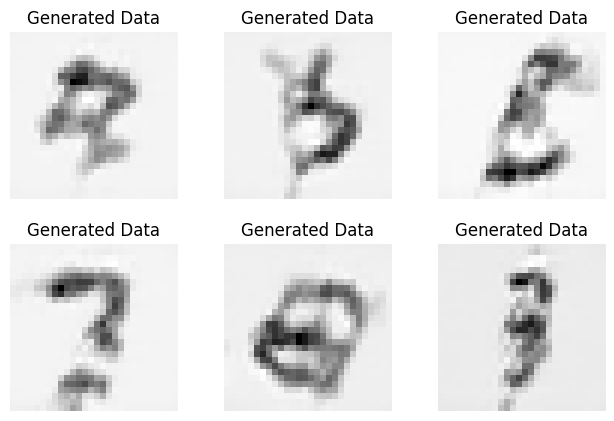

epoch 8


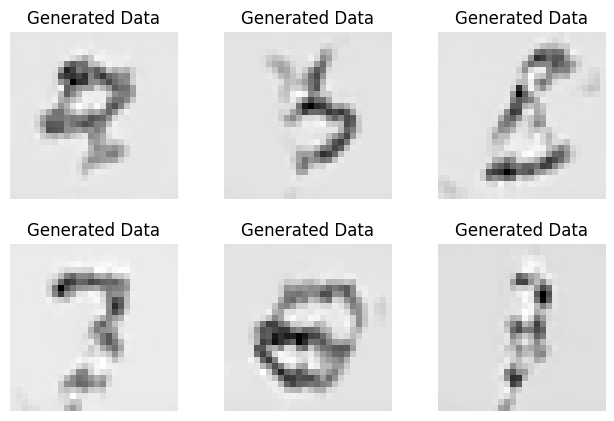

epoch 9


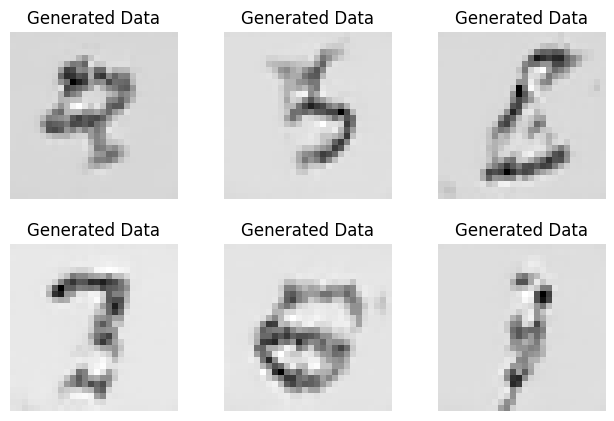

epoch 10


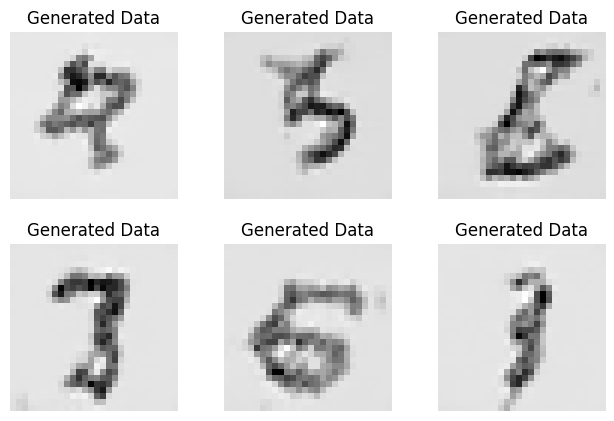

epoch 11


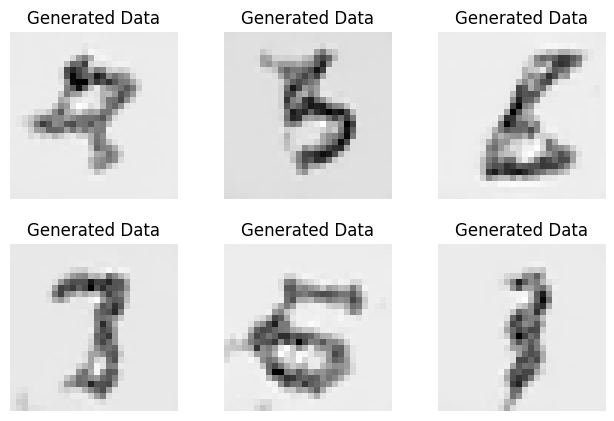

epoch 12


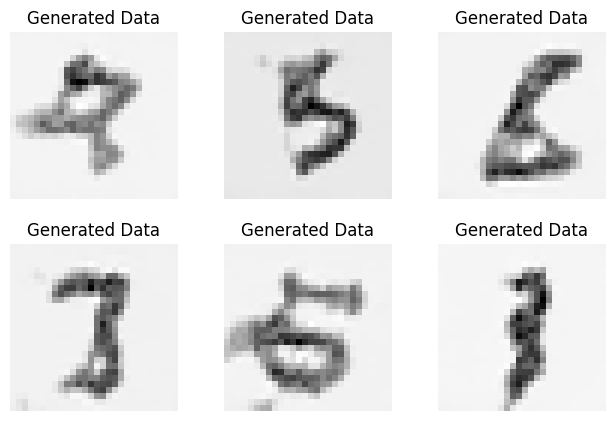

epoch 13


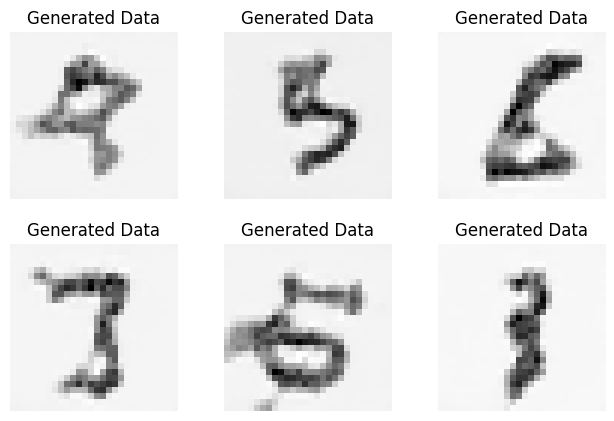

epoch 14


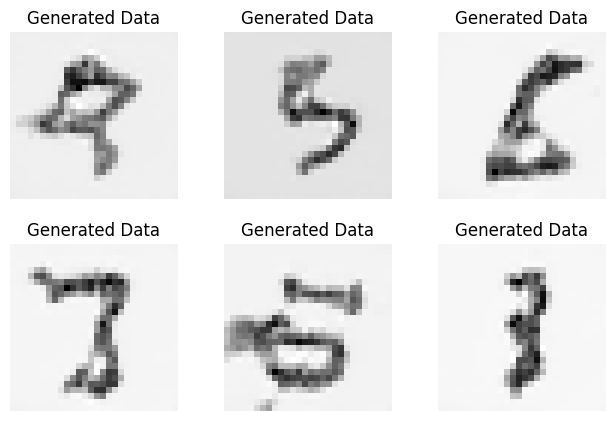

epoch 15


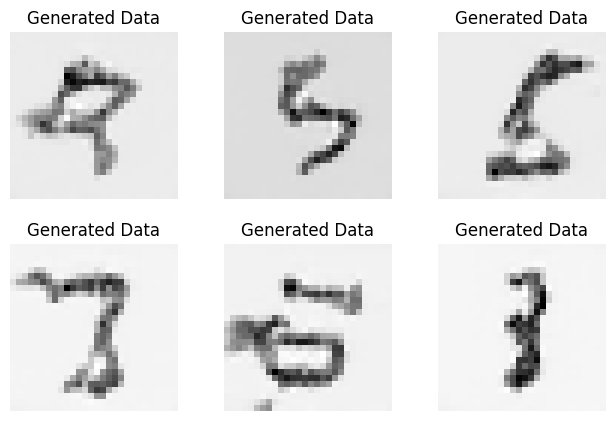

epoch 16


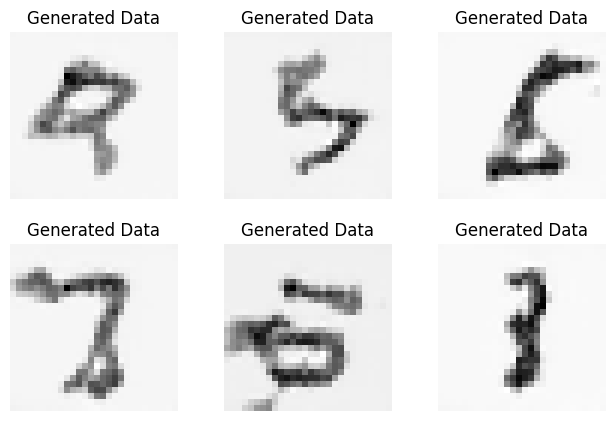

epoch 17


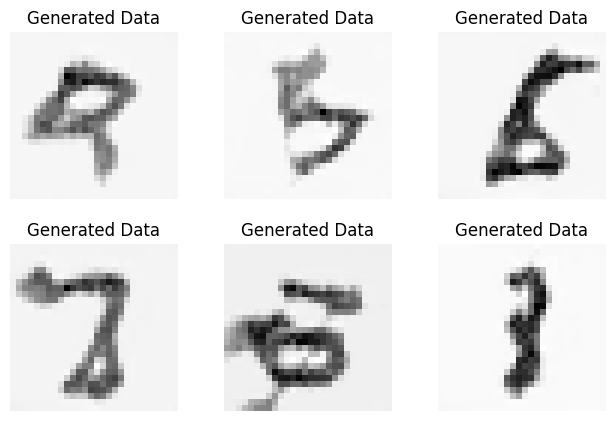

epoch 18


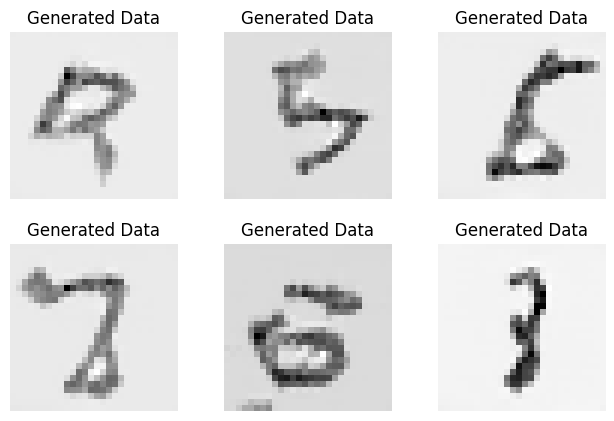

epoch 19


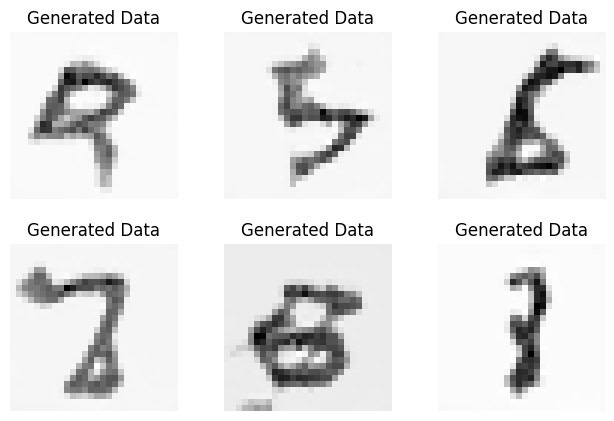

epoch 20


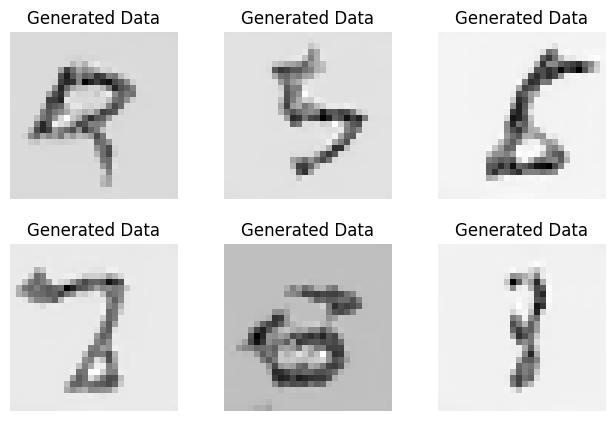

epoch 21


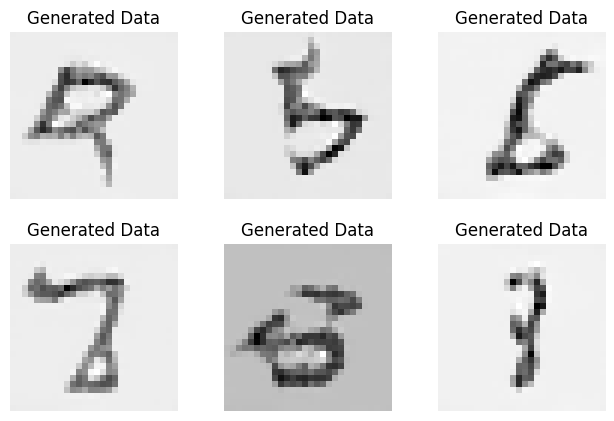

epoch 22


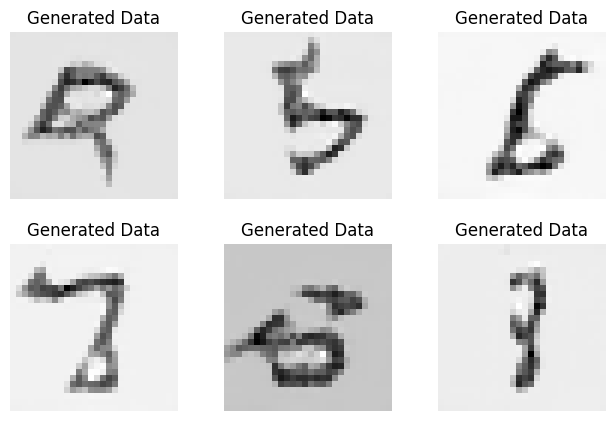

epoch 23


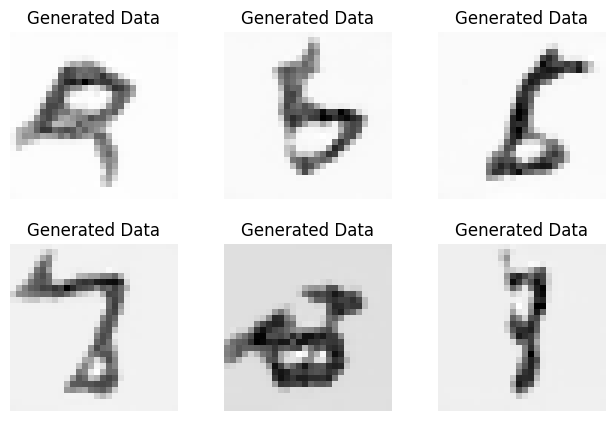

epoch 24


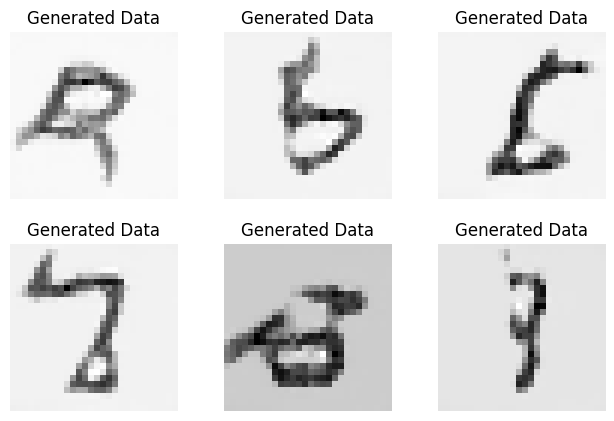

epoch 25


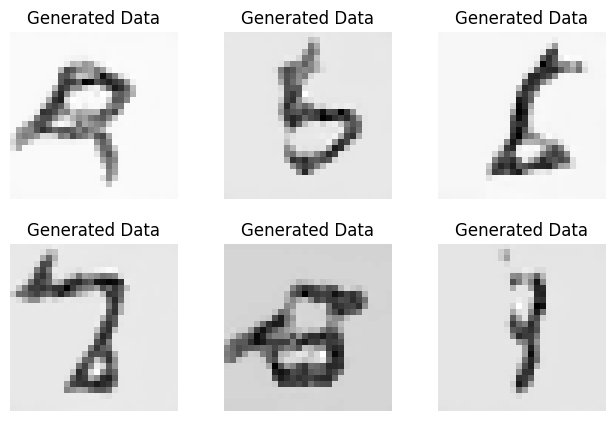

epoch 26


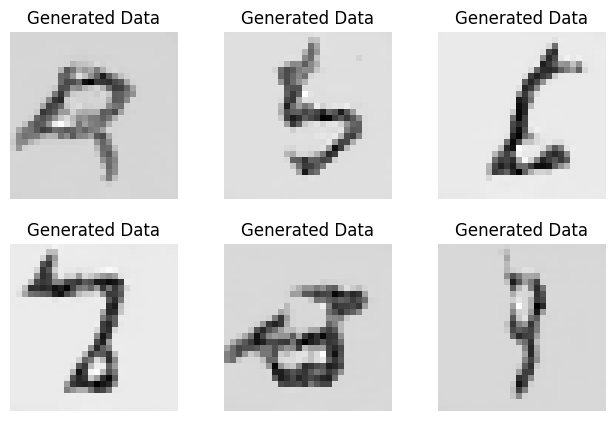

epoch 27


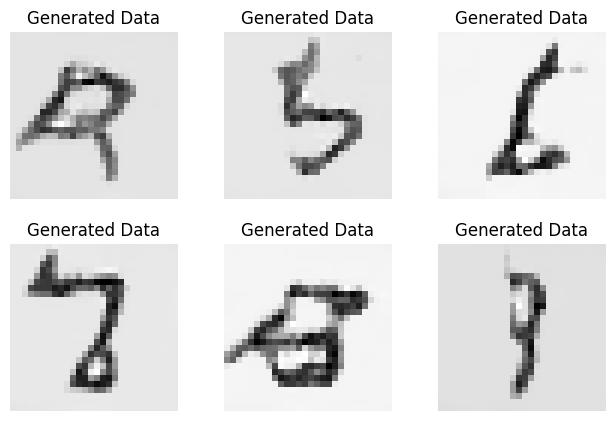

epoch 28


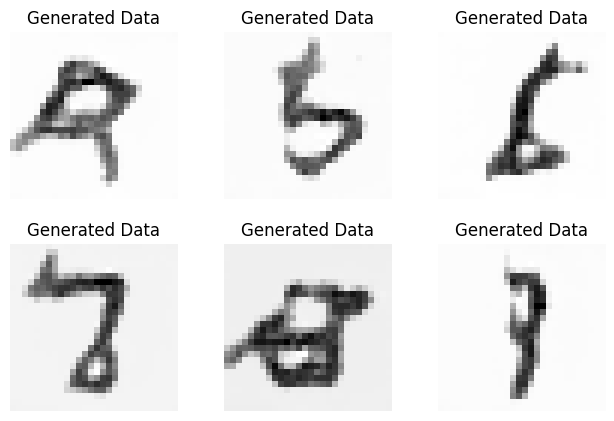

epoch 29


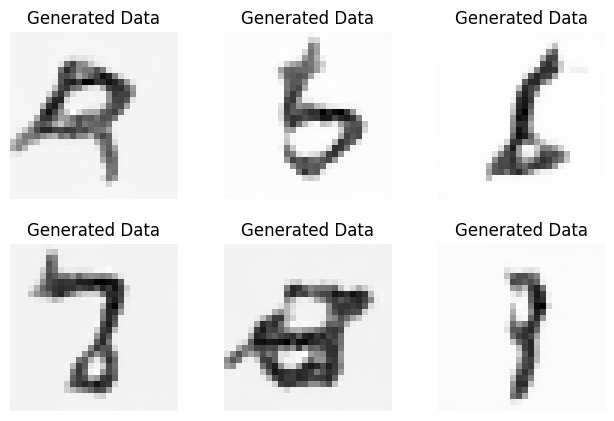

epoch 30


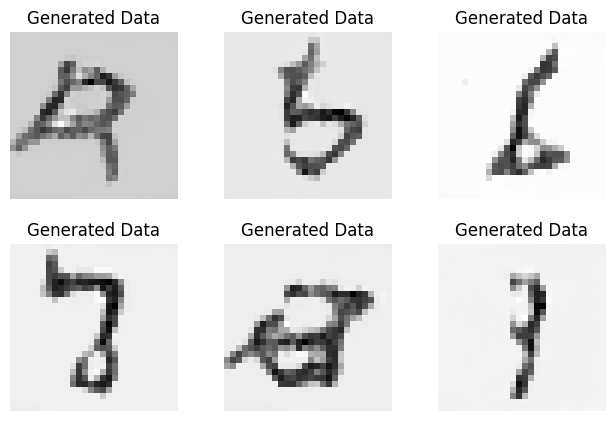

epoch 31


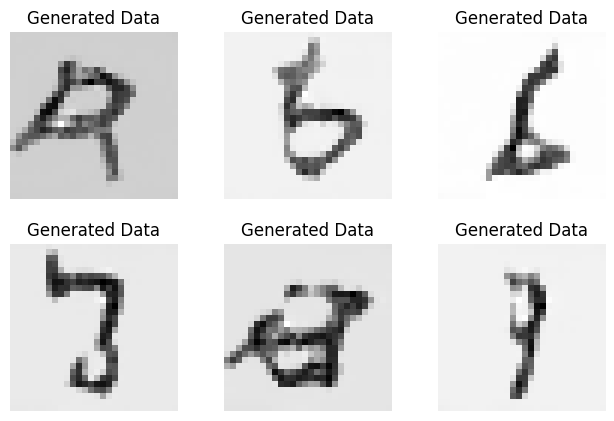

epoch 32


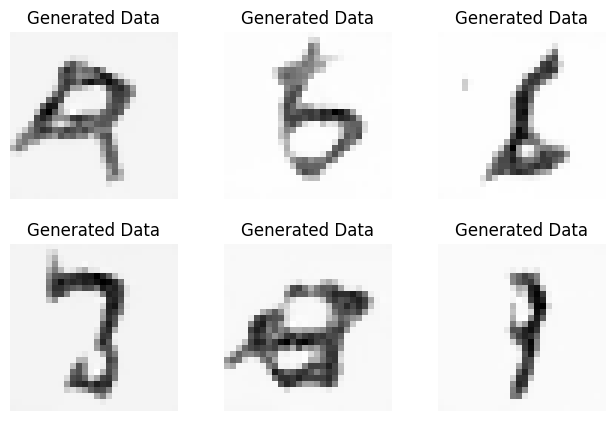

epoch 33


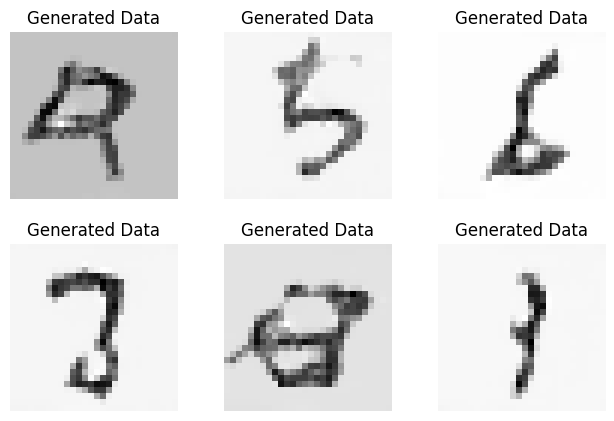

epoch 34


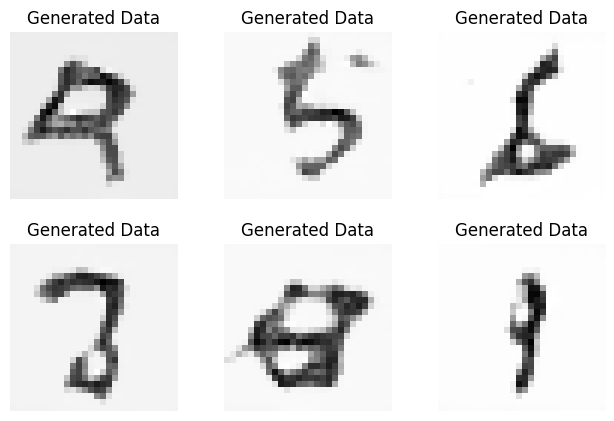

epoch 35


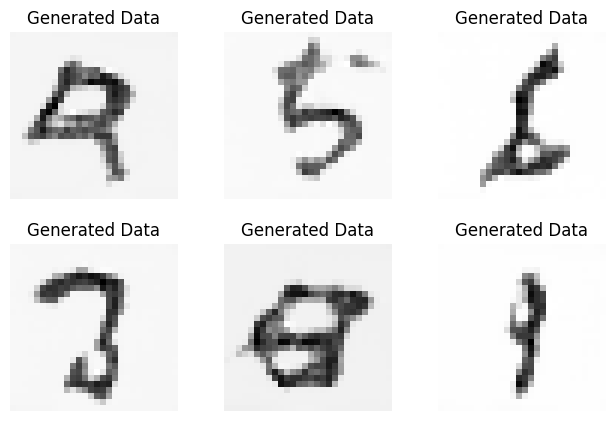

epoch 36


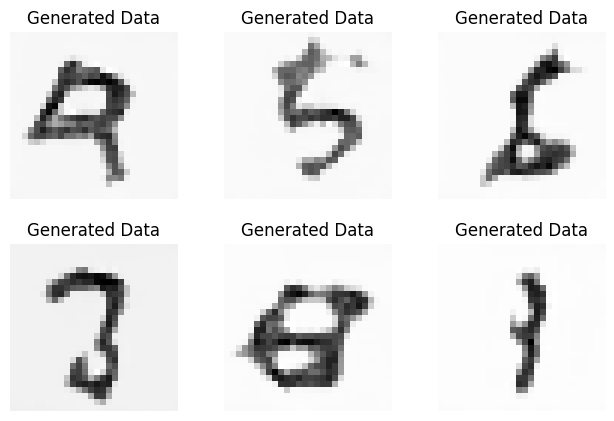

epoch 37


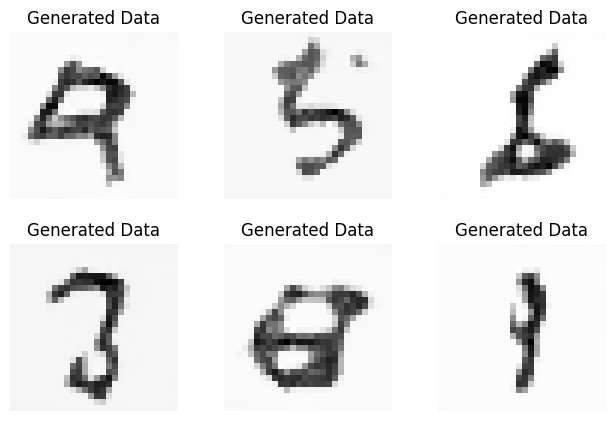

epoch 38


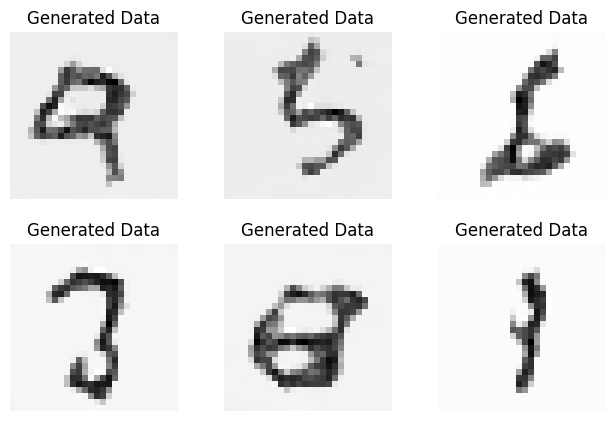

epoch 39


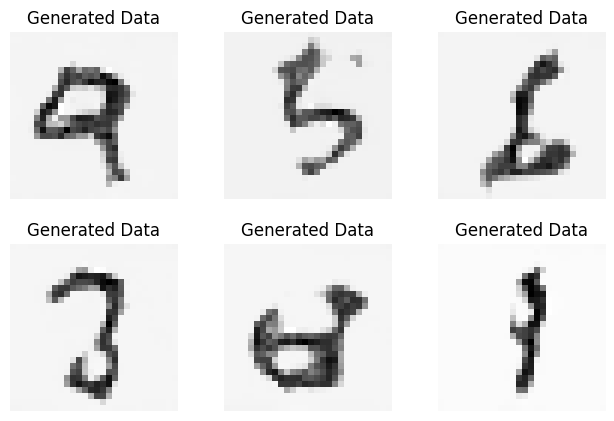

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=40` reached.


In [ ]:
 trainer = pl.Trainer(max_epochs=40, accelerator='gpu', devices=AVAIL_GPUS)
trainer.fit(model, dm)

# Adversarial Example Generation-- using pytorch

Adversarial Generation is the core idea behind GANs.

It simply means:
**A model learns to generate realistic data by fighting another model in a game.**

“Adversarial” = two models compete ,
“Generation” = produce new realistic samples

So, Adversarial Generation = generating data through a competitive learning process.

Two of which are: **white-box and black-box**.
* A white-box attack assumes the attacker has full knowledge and access to the model, including architecture, inputs, outputs, and weights.
* A black-box attack assumes the attacker only has access to the inputs and outputs of the model, and knows nothing about the underlying architecture or weights.

In [ ]:
import torch    # The core PyTorch library provides tensor data structures,
                                # manipulate tensors (torch.Tensor),training neural networks(torch.autograd),
                                # To move data and models to GPU (tensor.to(device)).
import torch.nn as nn  # The torch.nn module is PyTorch’s high-level neural network library, Key classes: nn.Module,nn.Linear,nn.Conv2d,nn.Dropout,nn.Upsample
import torch.nn.functional as F #provides functional versions of neural network operations, F.cross_entropy(logits, targets)
import torch.optim as optim     #The optimization (optimizer) module, optim.SGD(model.parameters(), lr=…, momentum=…), optim.Adam(model.parameters(), lr=…, betas=(…, …))
from torchvision import datasets, transforms # A PyTorch package specifically for computer vision,Standard image datasets (datasets),Image transformations (transforms)
import numpy as np #To convert PyTorch tensors to Numpy arrays (tensor.numpy())
import matplotlib.pyplot as plt #To visualize data

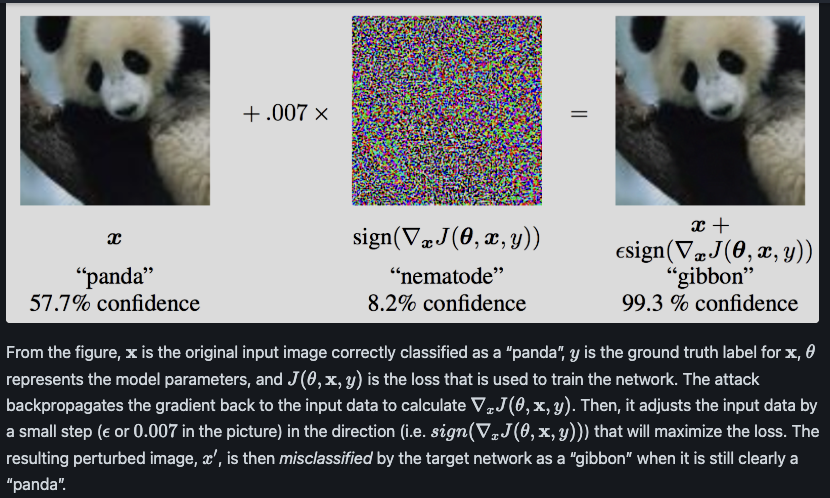

In [ ]:
epsilons = [0, .05, .1, .15, .2, .25, .3] #In adversarial attacks (like FGSM), epsilon (ε) controls the strength of the perturbation add to an image.
pretrained_model = "data/lenet_mnist_model.pth"
# Set random seed for reproducibility
torch.manual_seed(42)

In [ ]:
import torch.optim as optim
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import torch.nn.functional as F

# LeNet Model definition (moved here for self-contained training cell)
class Net(nn.Module):                           #Defines a new neural-network class named Net
    def __init__(self):                         #__init__ is the constructor that runs when you create Net().
        super(Net, self).__init__()             #super(Net, self).__init__() calls the parent (nn.Module) constructor to set up internal machinery (so PyTorch can register parameters, submodules, buffers, etc.).
        self.conv1 = nn.Conv2d(1, 32, 3, 1)     #First convolutional layer,input has 1 channel,produces 32 feature maps, 3×3 convolution kernel,filter moves 1 pixel at a time.
        self.conv2 = nn.Conv2d(32, 64, 3, 1)    #Second convolutional laye, conv1 output,
        self.dropout1 = nn.Dropout(0.25)
        self.dropout2 = nn.Dropout(0.5)
        self.fc1 = nn.Linear(9216, 128)
        self.fc2 = nn.Linear(128, 10)

    def forward(self, x):
        x = self.conv1(x)
        x = F.relu(x)
        x = self.conv2(x)
        x = F.relu(x)
        x = F.max_pool2d(x, 2)
        x = self.dropout1(x)
        x = torch.flatten(x, 1)
        x = self.fc1(x)
        x = F.relu(x)
        x = self.dropout2(x)
        x = self.fc2(x)
        output = F.log_softmax(x, dim=1)
        return output

# MNIST Training dataset and dataloader declaration
train_loader = torch.utils.data.DataLoader(
    datasets.MNIST('./data', train=True, download=True,
                   transform=transforms.Compose([
                       transforms.ToTensor(),
                       transforms.Normalize((0.1307,), (0.3081,))
                   ])),
    batch_size=64, shuffle=True
)

# We want to be able to train our model on an `accelerator <https://pytorch.org/docs/stable/torch.html#accelerators>`__
# such as CUDA, MPS, MTIA, or XPU. If the current accelerator is available, we will use it. Otherwise, we use the CPU.
device = torch.accelerator.current_accelerator().type if torch.accelerator.is_available() else "cpu"
print(f"Using {device} device for local training")

# Initialize the network for training
trained_lenet_model = Net().to(device)

# Optimizer
optimizer = optim.SGD(trained_lenet_model.parameters(), lr=0.01, momentum=0.5)

def train_model(model, device, train_loader, optimizer, epochs):
    model.train()
    for epoch in range(epochs):
        for batch_idx, (data, target) in enumerate(train_loader):
            data, target = data.to(device), target.to(device)
            optimizer.zero_grad()
            output = model(data)
            loss = F.nll_loss(output, target)
            loss.backward()
            optimizer.step()
            if batch_idx % 100 == 0:
                print(f"Train Epoch: {epoch} [{batch_idx * len(data)}/{len(train_loader.dataset)} ({100. * batch_idx / len(train_loader):.0f}%)]\tLoss: {loss.item():.6f}")

# Train the model
print("Training LeNet model locally...")
# pretrained_model variable is defined in the previous cell
train_model(trained_lenet_model, device, train_loader, optimizer, epochs=1) # Train for 1 epoch for quick demo

# Save the trained model's state dictionary
torch.save(trained_lenet_model.state_dict(), pretrained_model)
print(f"Model saved to {pretrained_model}")

# MNIST Test dataset and dataloader declaration
test_loader = torch.utils.data.DataLoader(
    datasets.MNIST('../data', train=False, download=True, transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.1307,), (0.3081,)),
            ])),
        batch_size=1, shuffle=True)

# Initialize the network for evaluation
model = Net().to(device)

# Load the pretrained model (now locally trained and saved)
# The 'weights_only=True' parameter caused issues; it's generally used for full model pickles, not state_dicts.
# Removing it as we are loading a state_dict.
model.load_state_dict(torch.load(pretrained_model, map_location=device, weights_only=True))

# Set the model in evaluation mode. In this case this is for the Dropout layers
model.eval()

Using cpu device for local training
Training LeNet model locally...
Train Epoch: 0 [0/60000 (0%)]	Loss: 2.304451
Train Epoch: 0 [6400/60000 (11%)]	Loss: 0.667446
Train Epoch: 0 [12800/60000 (21%)]	Loss: 0.521489
Train Epoch: 0 [19200/60000 (32%)]	Loss: 0.429459
Train Epoch: 0 [25600/60000 (43%)]	Loss: 0.334482
Train Epoch: 0 [32000/60000 (53%)]	Loss: 0.337989
Train Epoch: 0 [38400/60000 (64%)]	Loss: 0.306328
Train Epoch: 0 [44800/60000 (75%)]	Loss: 0.291167
Train Epoch: 0 [51200/60000 (85%)]	Loss: 0.275864
Train Epoch: 0 [57600/60000 (96%)]	Loss: 0.165056
Model saved to data/lenet_mnist_model.pth


Net(
  (conv1): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1))
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (dropout1): Dropout(p=0.25, inplace=False)
  (dropout2): Dropout(p=0.5, inplace=False)
  (fc1): Linear(in_features=9216, out_features=128, bias=True)
  (fc2): Linear(in_features=128, out_features=10, bias=True)
)

## FGSM attack

In [ ]:
def fgsm_attack(image, epsilon, data_grad):
  sign_data_grad = data_grad.sign()
  perturbed_image = image + epsilon*sign_data_grad
  perturbed_image = torch.clamp(perturbed_image,0,1)
  return perturbed_image

def denorm(batch, mean=[0.1307], std=[0.3081]):
  if isinstance(mean,list):
    mean =torch.tensor(mean).to(device)
  if isinstance(std, list):
    std = torch.tensor(std).to(device)

  return batch*std.view(1,-1,1,1)+mean.view(1,-1,-1,1)

## Testing Function

In [ ]:
def test (model, device, test_loader, epsilon):
  correct = 0
  adv_examples = []

  for data , target in test_loader:
    data, target = data.to(device), target.to(device)
    data.requires_grad = True
    output = model(data)
    init_pred = output.max(1, keepdim=True)[1]

    if init_pred.item() != target.item():
      continue
    loss = F.nll_loss(output, target)
    model.zero_grad()
    loss.backward
    data_grad = data.grad.data
    data_denorm = denorm(data)
    perturbed_data = fgsm_attack(data_denorm, epsilon, data_grad)
    perturbed_data_normalized = transforms.Normalize((0.1307,), (0.3081,))(perturbed_data)
    output = model(perturbed_data_normalized)

    final_pred = output.max(1, keepdim=True)[1]
    if final_pred.item() == target.item():
      correct += 1
      if (epsilon == 0) and (len(adv_examples) < 5):
        adv_ex = perturbed_data.squeeze().detach().cpu().numpy()
        adv_examples.append((init_pred.item(), final_pred.item(), adv_ex))
      else :
        if len(adv_examples) < 5:
          adv_ex = perturbed_data.squeeze().detach().cpu().numpy
          adv_examples.append((init_pred.item(), final_pred.item(), adv_ex))

  final_acc = correct/float(len(test_loader))
  print("Epsilon: {}\tTest Accuracy = {} / {} = {}".format(epsilon, correct, len(test_loader), final_acc))
  return final_acc, adv_examples


# Run Attack
accuracies = []
examples = []

for eps in epsilons:
  acc, ex = test(model, device, test_loader, eps)
  accuracies.append(acc)
  examples.append(ex)
  print(f"Epsilon: {eps}")
  print(f"Accuracy: {acc}")
  print(f"Examples: {ex}")


plt.figure(figsize=(5,5))
plt.plot(epsilons, accuracies, "*-")
plt.yticks(np.arange(0, 1.1, step=0.1))
plt.xticks(np.arange(0, .35, step=0.05))
plt.title("Accuracy vs Epsilon")
plt.xlabel("Epsilon")
plt.ylabel("Accuracy")
plt.show()

In [ ]:
# simple adversarial
cnt = 0
plt.figure(figsize=(8,10))
for i in range(len(epsilons)):
    for j in range(len(examples[i])):
        cnt += 1
        plt.subplot(len(epsilons),len(examples[0]),cnt)
        plt.xticks([], [])
        plt.yticks([], [])
        if j == 0:
            plt.ylabel(f"Eps: {epsilons[i]}", fontsize=14)
        orig,adv,ex = examples[i][j]
        plt.title(f"{orig} -> {adv}")
        plt.imshow(ex, cmap="gray")
plt.tight_layout()
plt.show()

# small face-generation model with the Dataset provide raw

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!ls "/content/drive/MyDrive"

 AI-Liance.zip			     'Model Comparison & Discussion.gdoc'
 AIMS_lab			      myCV.pdf
'Assessment report.gdoc'	     'Resume .pdf'
 Banner_HSBC.jpg		      Resume-Saib-hossain.pdf
'Celebrity faces'		     'Resume_Updated (1).pdf'
'CENTeR Voucher - saib hossain.pdf'  'RHCSA Certificate - saib hossain.pdf'
 Classroom			     'robotics_Mars_rover Resume.pdf'
'Colab Notebooks'		      saib_IDP_Volunteer_CV.pdf
'Md Saib Hossain-01769918015.gdoc'   'Untitled document.gdoc'
'MD Saib Hossain (1).pdf'


In [ ]:
data_path = "/content/drive/MyDrive/Celebrity faces"

cpu
Epoch [1/50]  Loss D: 0.0747  Loss G: 6.9417


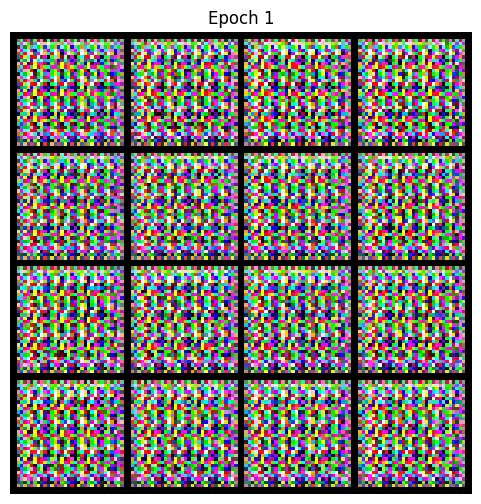

Epoch [2/50]  Loss D: 0.0316  Loss G: 7.3223


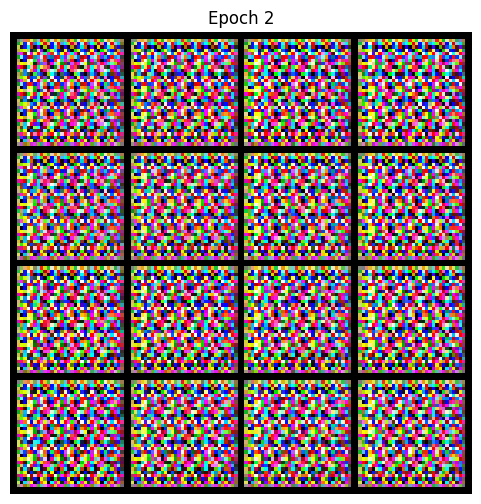

Epoch [3/50]  Loss D: 0.0192  Loss G: 8.1788


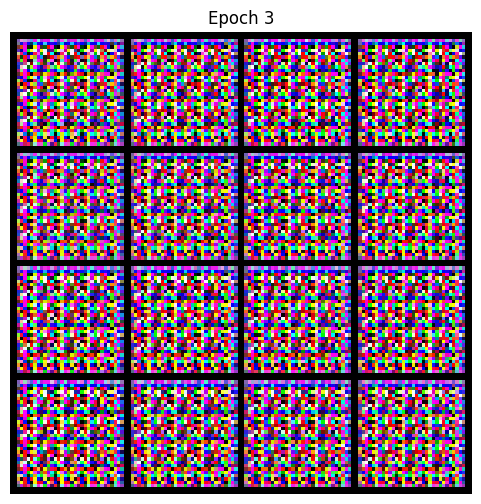

Epoch [4/50]  Loss D: 0.0103  Loss G: 7.7477


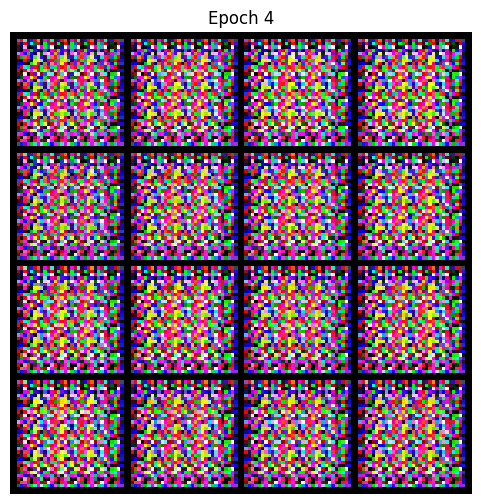

Epoch [5/50]  Loss D: 0.0072  Loss G: 8.1296


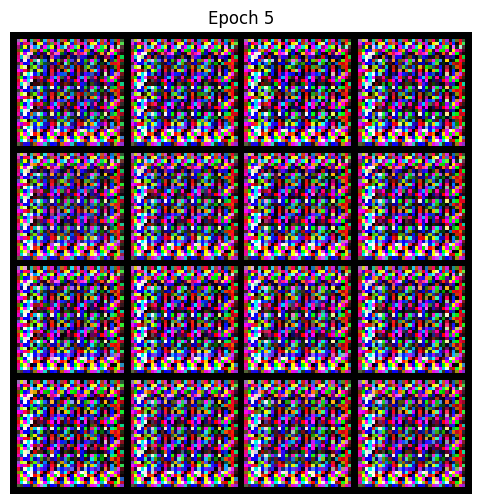

Epoch [6/50]  Loss D: 0.0076  Loss G: 7.8667


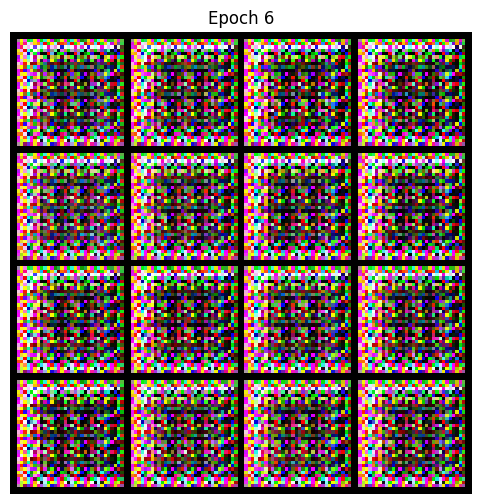

Epoch [7/50]  Loss D: 0.0059  Loss G: 7.7762


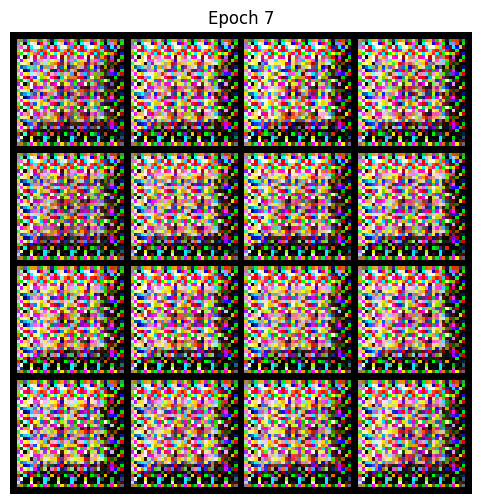

Epoch [8/50]  Loss D: 0.0037  Loss G: 7.8956


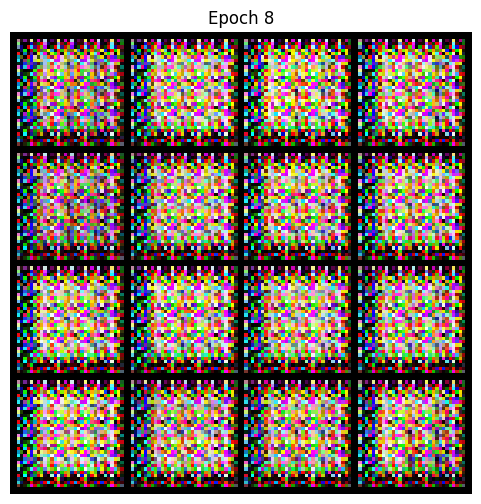

Epoch [9/50]  Loss D: 0.0049  Loss G: 7.9580


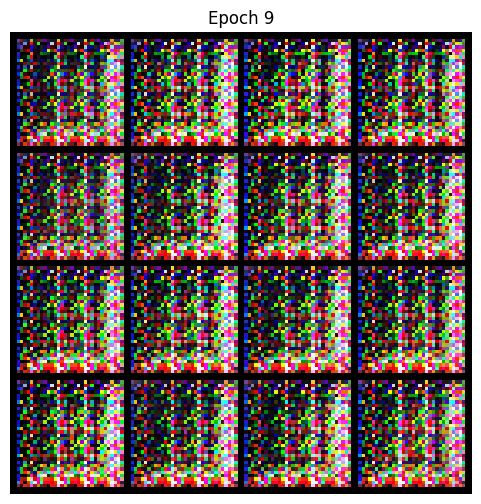

Epoch [10/50]  Loss D: 0.0041  Loss G: 7.7630


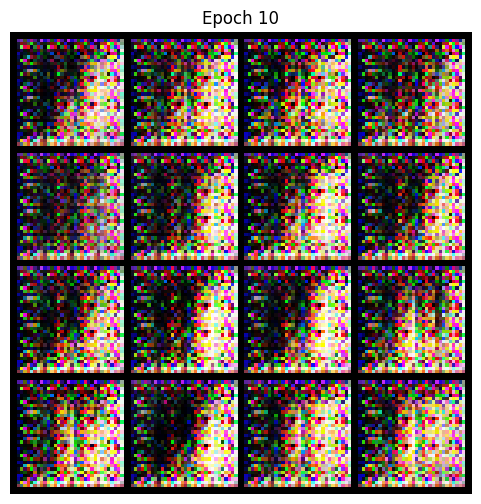

Epoch [11/50]  Loss D: 0.0075  Loss G: 7.3444


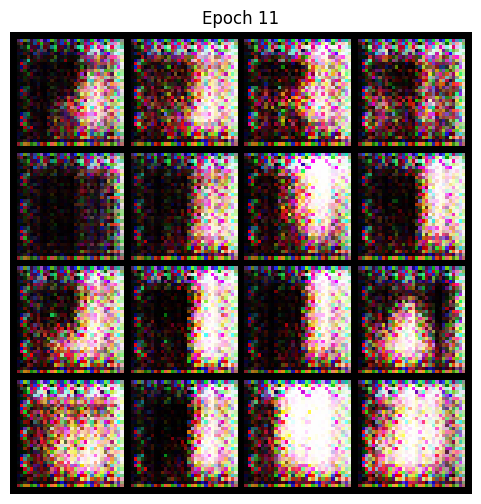

Epoch [12/50]  Loss D: 0.0117  Loss G: 7.8965


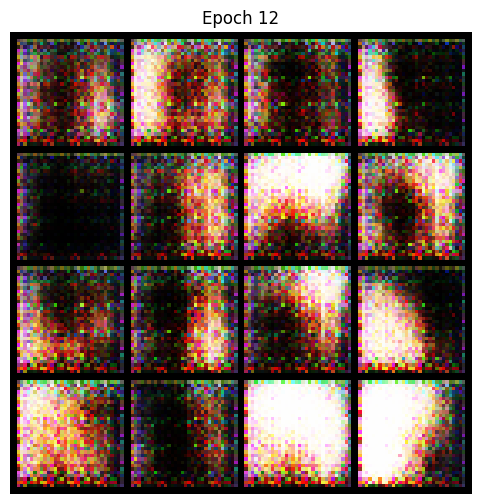

Epoch [13/50]  Loss D: 0.0048  Loss G: 7.2817


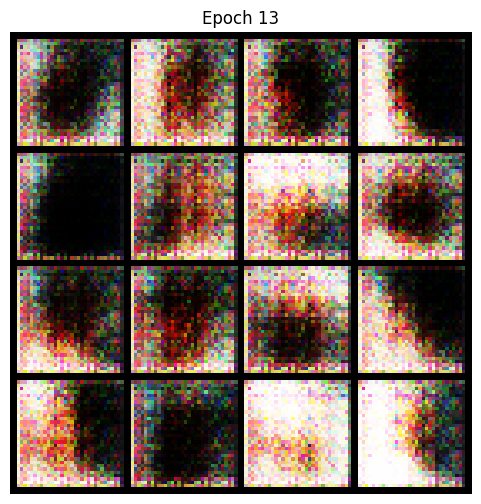

Epoch [14/50]  Loss D: 0.0036  Loss G: 7.2180


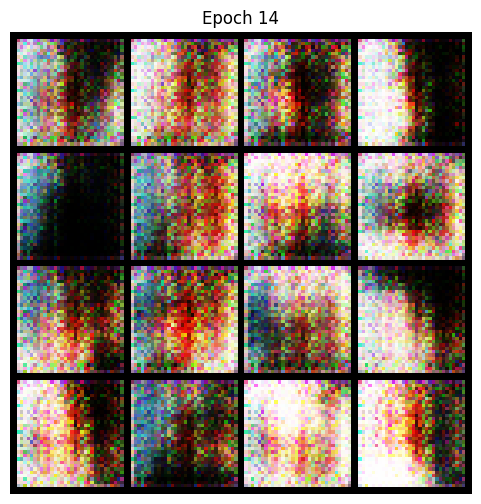

Epoch [15/50]  Loss D: 0.0034  Loss G: 7.2294


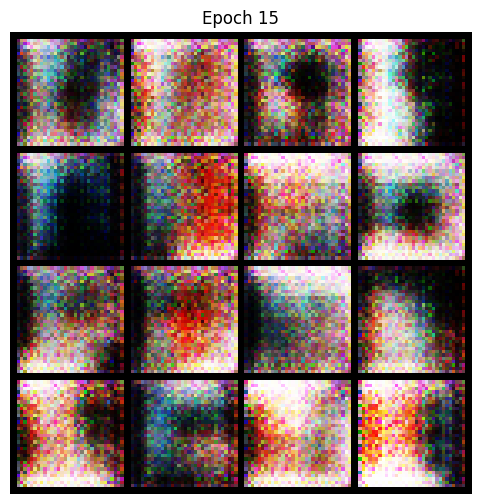

Epoch [16/50]  Loss D: 0.0026  Loss G: 7.3411


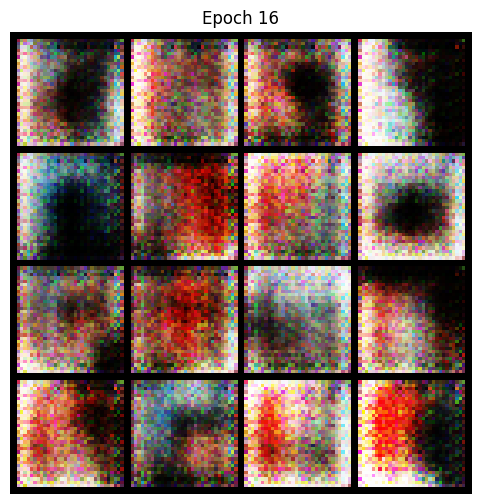

Epoch [17/50]  Loss D: 0.0019  Loss G: 7.5977


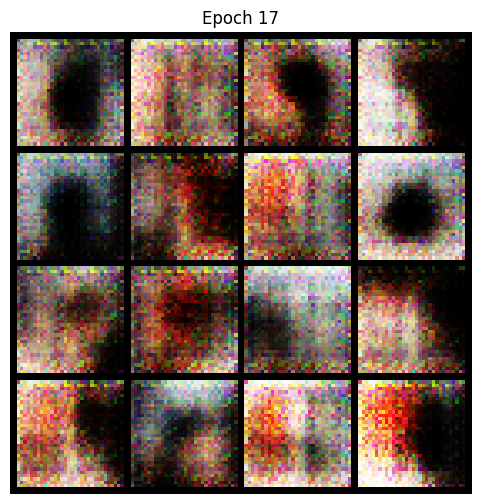

Epoch [18/50]  Loss D: 0.0023  Loss G: 7.4080


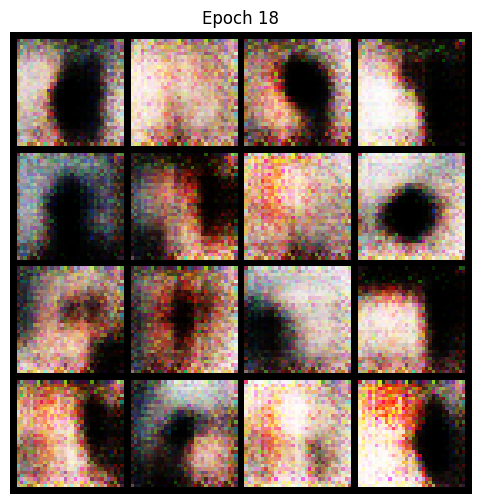

Epoch [19/50]  Loss D: 0.0018  Loss G: 7.7780


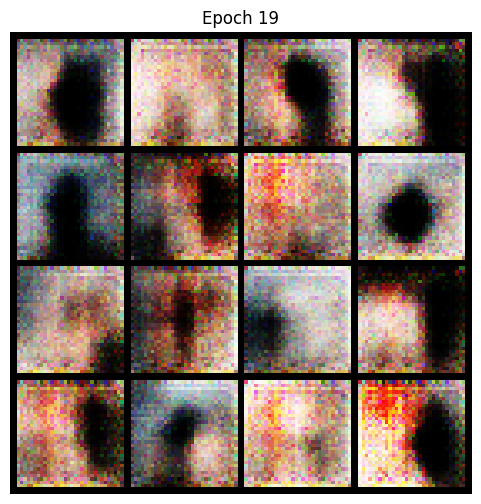

Epoch [20/50]  Loss D: 0.0015  Loss G: 7.6149


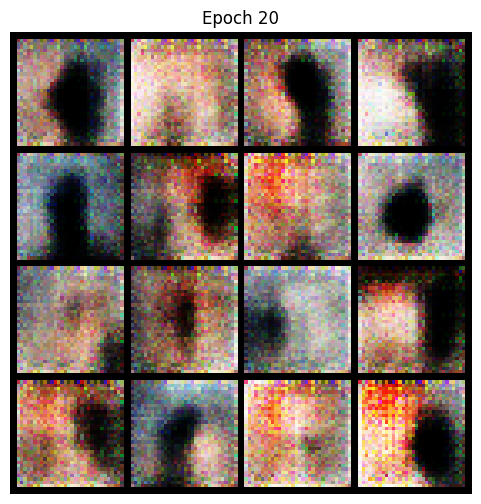

Epoch [21/50]  Loss D: 0.0016  Loss G: 8.1325


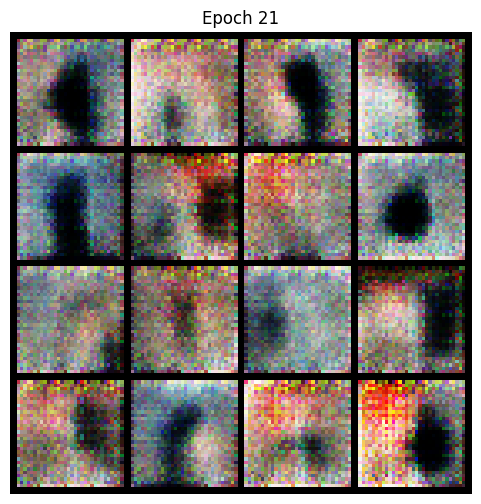

Epoch [22/50]  Loss D: 0.0015  Loss G: 7.8649


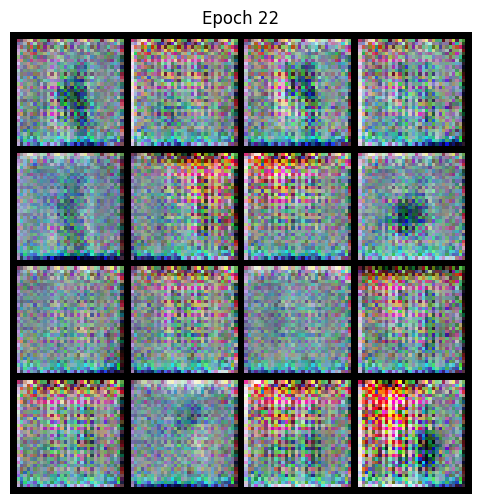

Epoch [23/50]  Loss D: 0.0010  Loss G: 7.8801


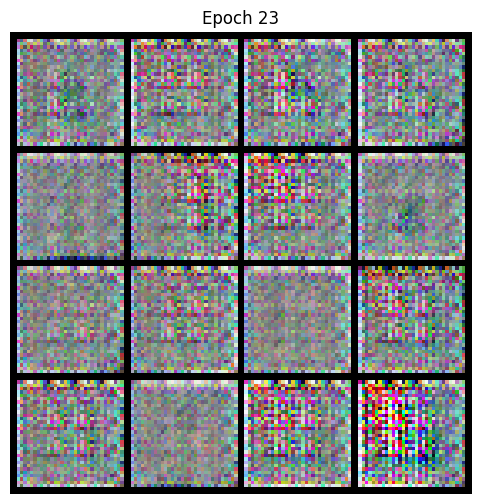

Epoch [24/50]  Loss D: 0.0008  Loss G: 8.4570


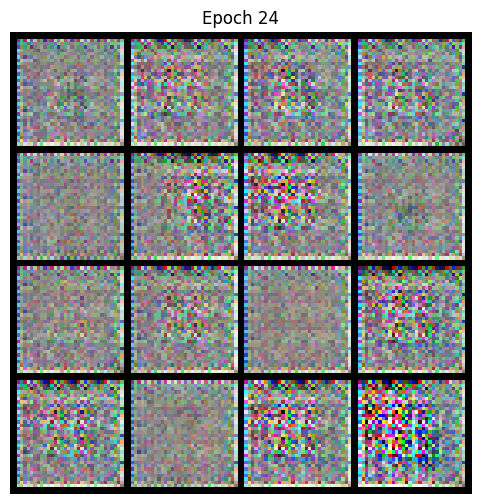

Epoch [25/50]  Loss D: 0.0005  Loss G: 8.8105


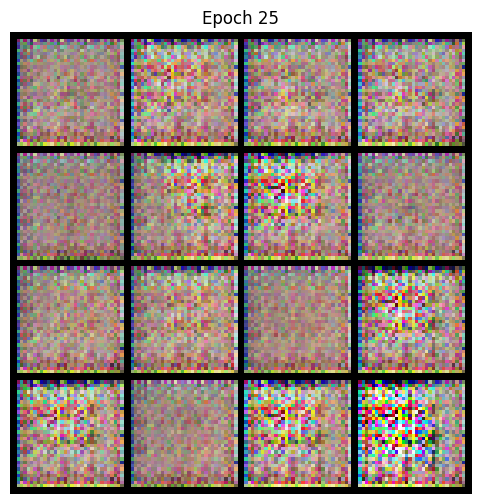

Epoch [26/50]  Loss D: 0.0006  Loss G: 8.3096


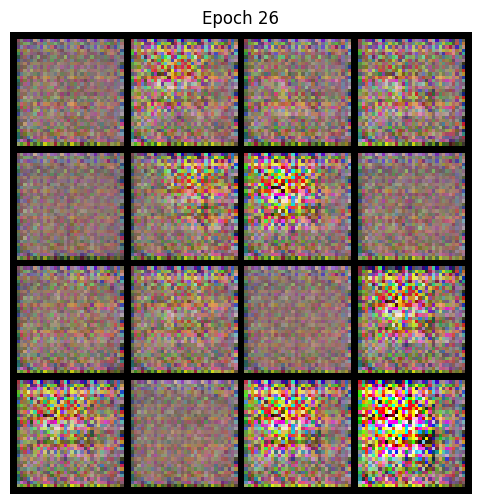

Epoch [27/50]  Loss D: 0.0012  Loss G: 7.9347


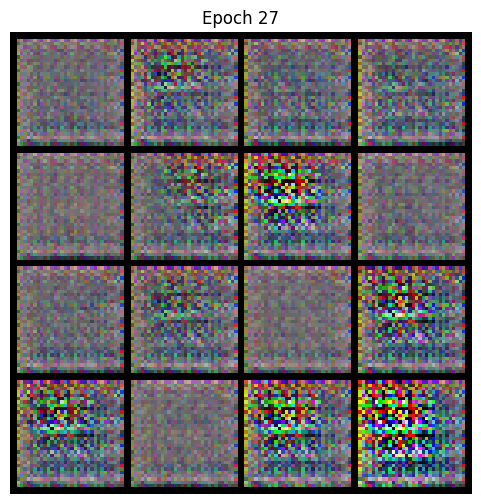

Epoch [28/50]  Loss D: 0.0008  Loss G: 8.7411


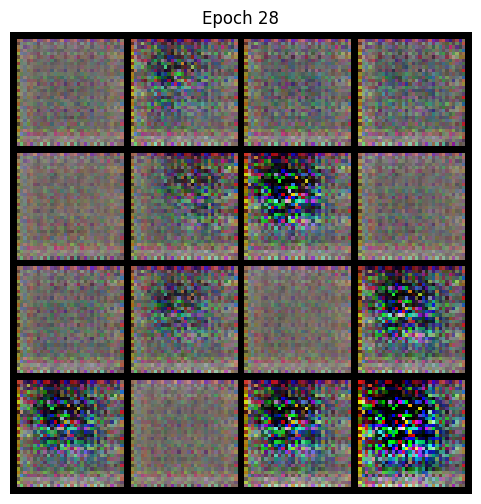

Epoch [29/50]  Loss D: 0.0003  Loss G: 10.0072


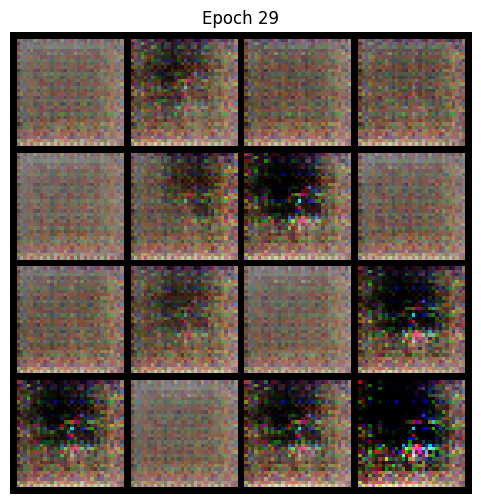

Epoch [30/50]  Loss D: 0.0004  Loss G: 9.7539


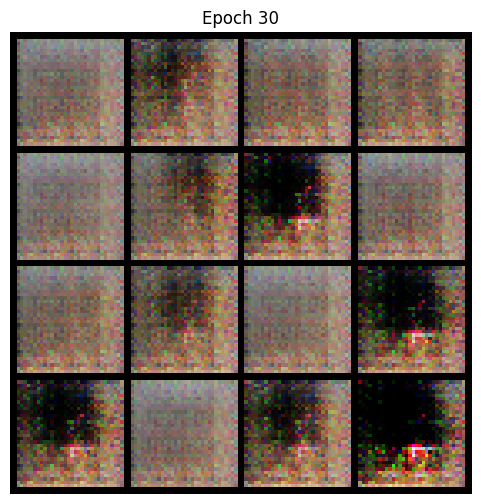

Epoch [31/50]  Loss D: 0.0007  Loss G: 9.1012


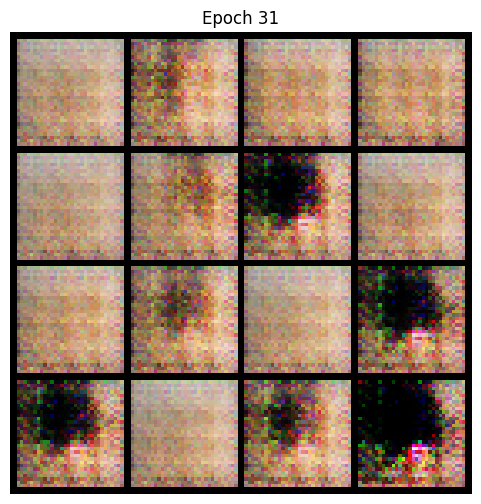

Epoch [32/50]  Loss D: 0.0007  Loss G: 9.0856


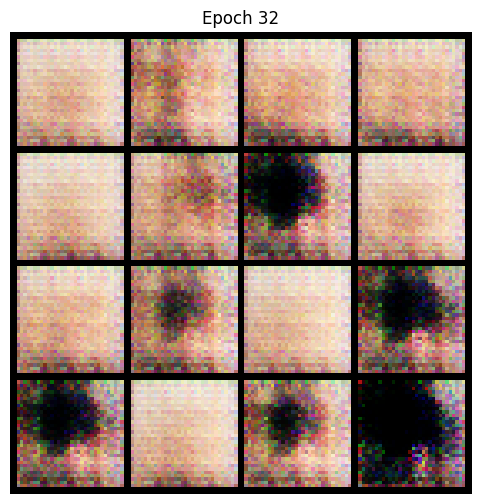

Epoch [33/50]  Loss D: 0.0005  Loss G: 8.8942


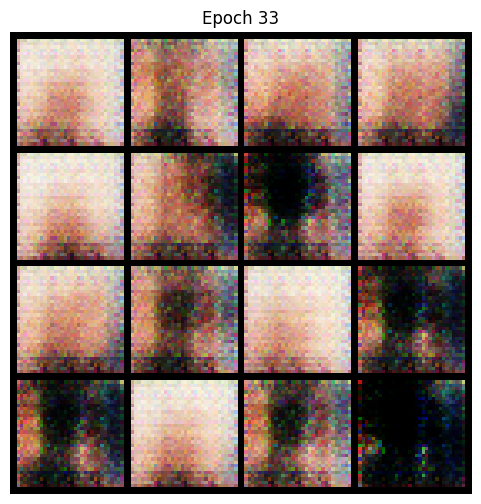

Epoch [34/50]  Loss D: 0.0005  Loss G: 9.0331


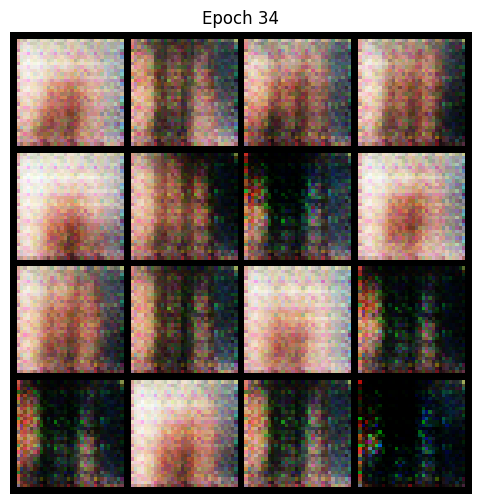

Epoch [35/50]  Loss D: 0.0005  Loss G: 9.0030


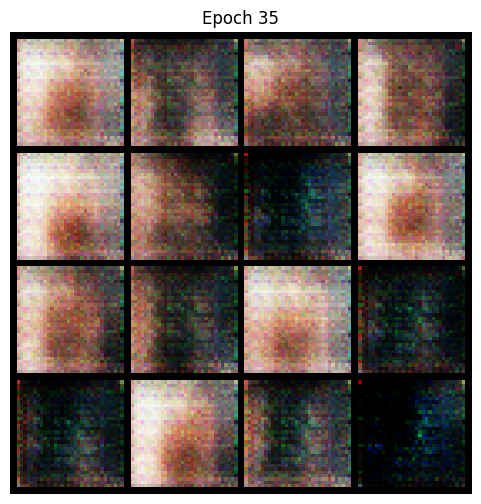

Epoch [36/50]  Loss D: 0.0004  Loss G: 9.1859


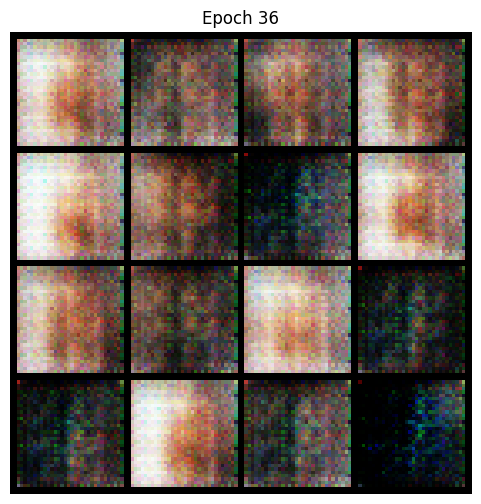

Epoch [37/50]  Loss D: 0.0004  Loss G: 9.4758


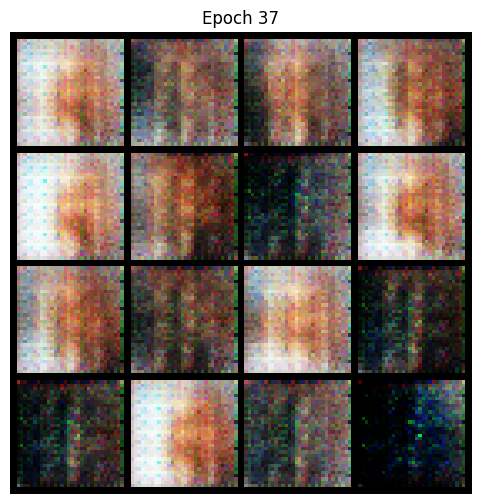

Epoch [38/50]  Loss D: 0.0005  Loss G: 9.1192


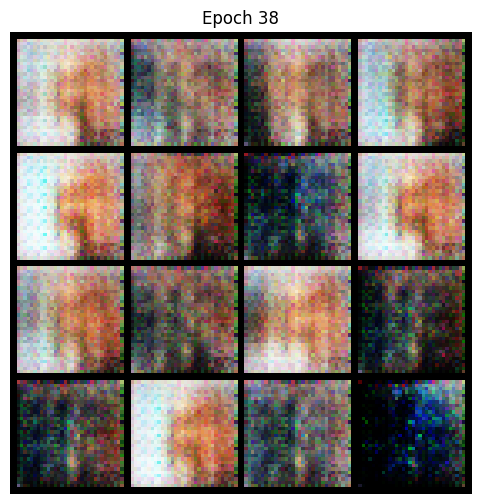

Epoch [39/50]  Loss D: 0.0005  Loss G: 8.8641


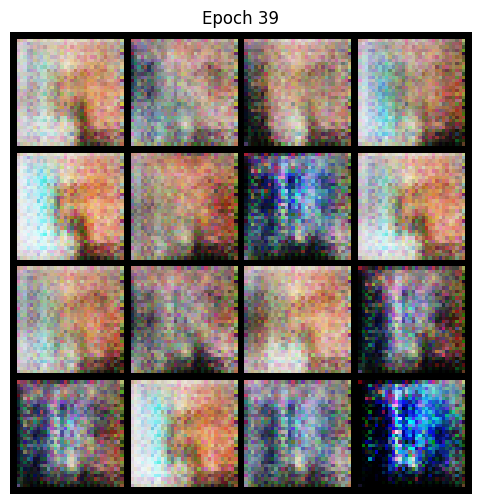

Epoch [40/50]  Loss D: 0.0004  Loss G: 9.1399


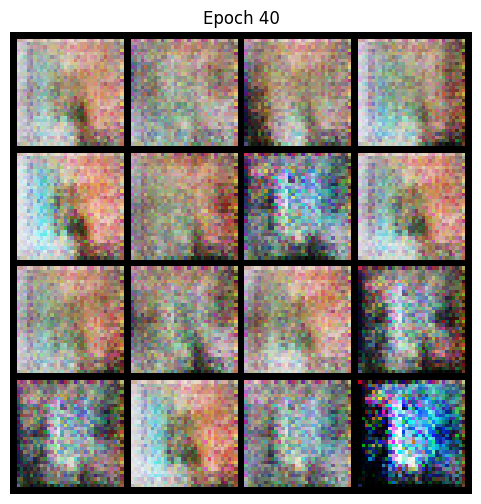

Epoch [41/50]  Loss D: 0.0004  Loss G: 8.7262


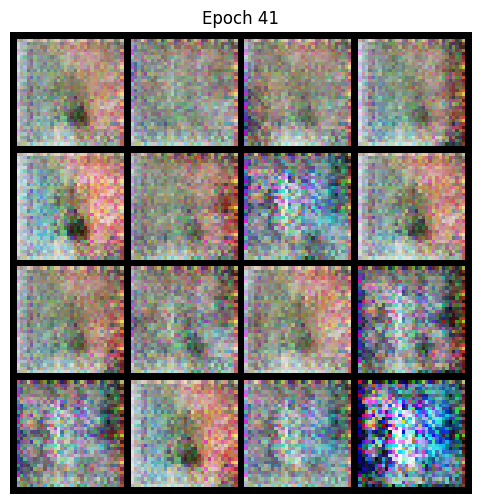

Epoch [42/50]  Loss D: 0.0003  Loss G: 8.9008


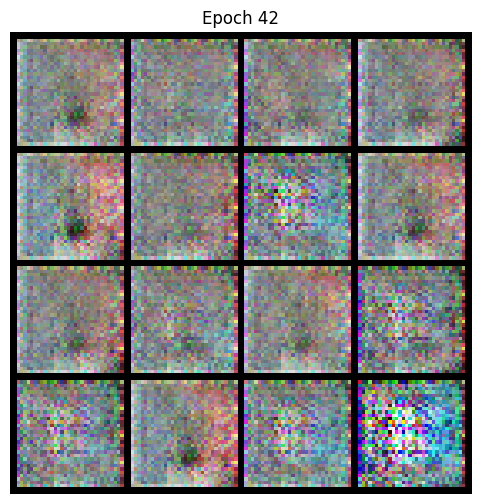

Epoch [43/50]  Loss D: 0.0003  Loss G: 9.0234


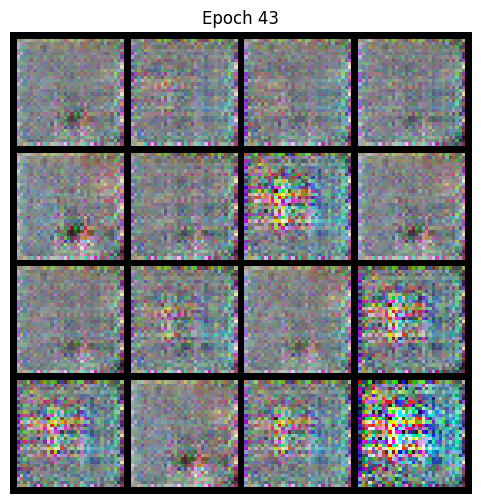

Epoch [44/50]  Loss D: 0.0002  Loss G: 8.9336


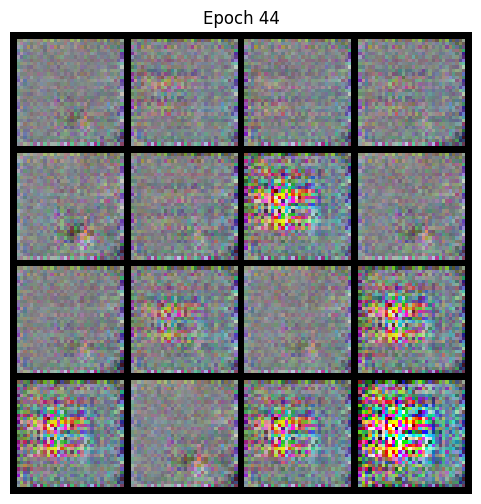

Epoch [45/50]  Loss D: 0.0003  Loss G: 8.9954


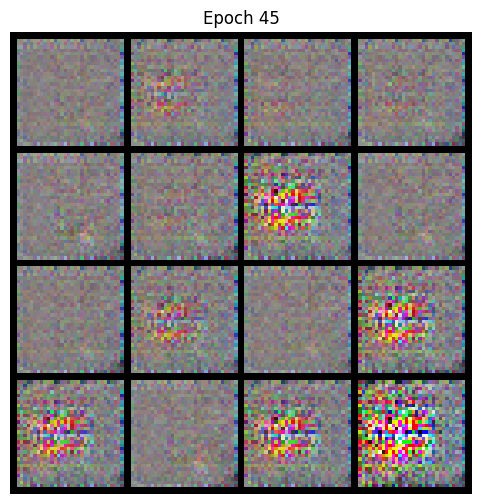

Epoch [46/50]  Loss D: 0.0007  Loss G: 8.2243


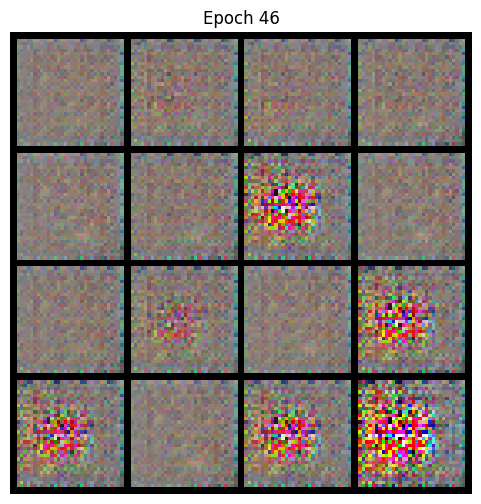

Epoch [47/50]  Loss D: 0.0004  Loss G: 8.8674


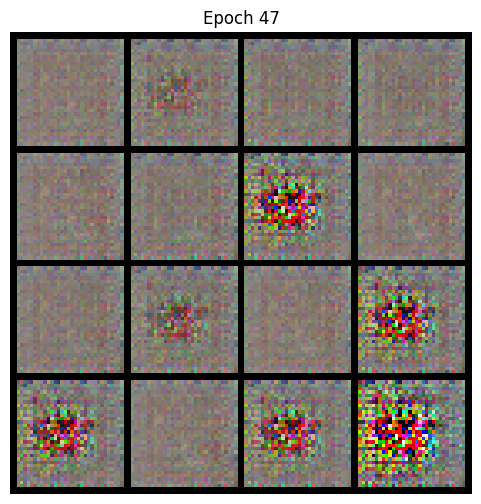

Epoch [48/50]  Loss D: 0.0004  Loss G: 9.4130


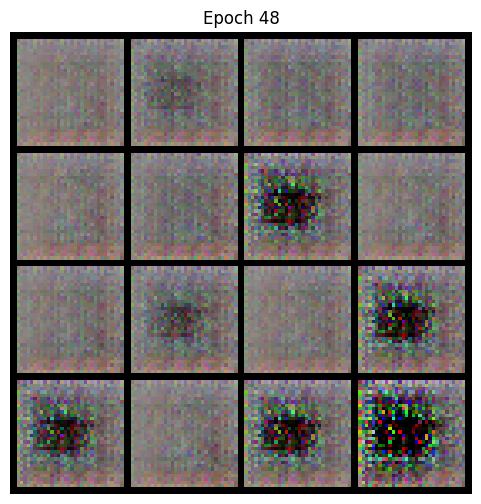

Epoch [49/50]  Loss D: 0.0002  Loss G: 9.8598


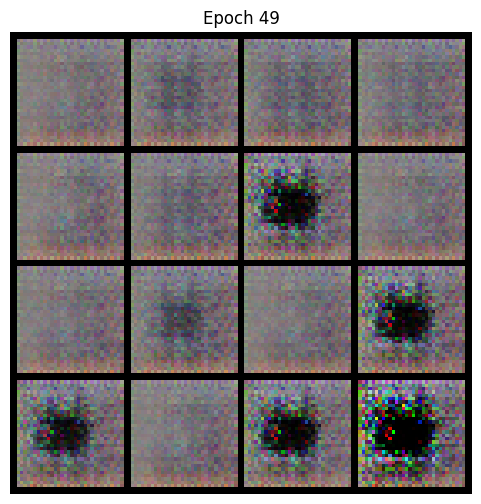

Epoch [50/50]  Loss D: 0.0003  Loss G: 9.6865


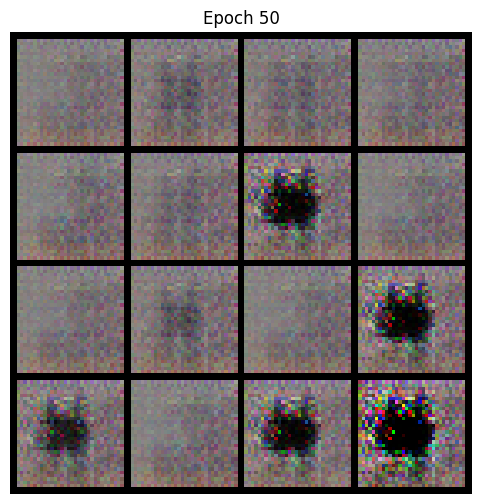

In [ ]:
import os
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torchvision import datasets, transforms, utils
import matplotlib.pyplot as plt
from IPython.display import display

data_path = "/content/drive/MyDrive/Celebrity faces"

transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.CenterCrop(64),
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5])
])

dataset = datasets.ImageFolder(root=data_path, transform=transform)
loader = DataLoader(dataset, batch_size=32, shuffle=True)
print(len(dataset))

class Generator(nn.Module):
    def __init__(self, z_dim=100):
        super().__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(z_dim, 512, 4, 1, 0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, x):
        return self.model(x)

class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.model = nn.Sequential(
            nn.Conv2d(3, 128, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(256, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(512, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x)

device = "cuda" if torch.cuda.is_available() else "cpu"

z_dim = 100
G = Generator(z_dim).to(device)
D = Discriminator().to(device)

criterion = nn.BCELoss()

opt_G = torch.optim.Adam(G.parameters(), lr=0.0002, betas=(0.5, 0.999))
opt_D = torch.optim.Adam(D.parameters(), lr=0.0002, betas=(0.5, 0.999))

epochs = 50
fixed_noise = torch.randn(16, z_dim, 1, 1, device=device)

for epoch in range(epochs):
    for real, _ in loader:
        real = real.to(device)
        batch_size = real.size(0)

        ### Train Discriminator ###
        noise = torch.randn(batch_size, z_dim, 1, 1, device=device)
        fake = G(noise)

        D_real = D(real).view(-1)
        D_fake = D(fake.detach()).view(-1)

        loss_D_real = criterion(D_real, torch.ones_like(D_real))
        loss_D_fake = criterion(D_fake, torch.zeros_like(D_fake))
        loss_D = loss_D_real + loss_D_fake

        opt_D.zero_grad()
        loss_D.backward()
        opt_D.step()

        ### Train Generator ###
        output = D(fake).view(-1)
        loss_G = criterion(output, torch.ones_like(output))

        opt_G.zero_grad()
        loss_G.backward()
        opt_G.step()

    print(f"Epoch [{epoch+1}/{epochs}]  Loss D: {loss_D:.4f}  Loss G: {loss_G:.4f}")

    # show generated samples
    with torch.no_grad():
        fake_samples = G(fixed_noise).cpu()
        grid = utils.make_grid(fake_samples, nrow=4, normalize=True)
        plt.figure(figsize=(6,6))
        plt.imshow(grid.permute(1,2,0))
        plt.title(f"Epoch {epoch+1}")
        plt.axis("off")
        plt.show()


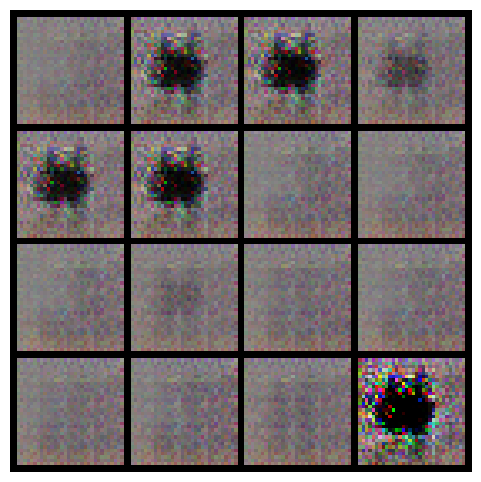

In [ ]:
noise = torch.randn(16, z_dim, 1, 1, device=device)
with torch.no_grad():
    fake_imgs = G(noise).cpu()

grid = utils.make_grid(fake_imgs, nrow=4, normalize=True)
plt.figure(figsize=(6,6))
plt.imshow(grid.permute(1,2,0))
plt.axis("off")
plt.show()

In [ ]:
!pip install facenet-pytorch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 73.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 86.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 99.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 755.5/755.5 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 63.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 34.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 36.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 13.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2

## DCGAN with more iteration expect to batter result

Starting face alignment (this may take a while the first time)...
Face alignment finished / skipped if already processed.
Aligned dataset size: 511 images, classes: ['Alia', 'Demi moore', 'Henry cavil', 'Johnny depp', 'Kristien', 'Sakib khan', 'Salman khan', 'Scarlet johansson', 'Shahrukh khan']
Model sizes - G params: 4.85M D params: 11.03M


Epoch 1/250: 100%|██████████| 32/32 [03:10<00:00,  5.94s/it, loss_D=0.5842, loss_G=6.1594, inst_sigma=0.0996]


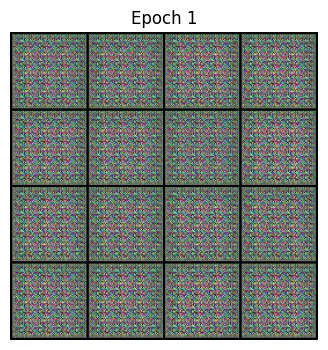

Epoch 2/250: 100%|██████████| 32/32 [02:45<00:00,  5.17s/it, loss_D=0.5719, loss_G=5.0790, inst_sigma=0.0992]


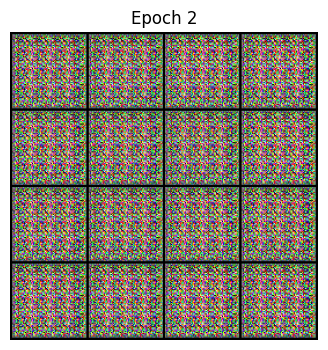

Epoch 3/250: 100%|██████████| 32/32 [02:27<00:00,  4.62s/it, loss_D=0.4424, loss_G=6.3150, inst_sigma=0.0988]


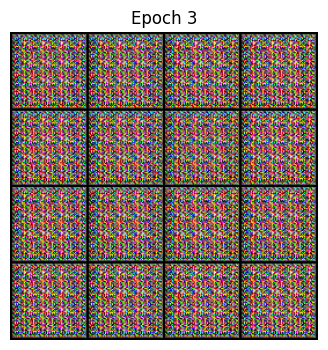

Epoch 4/250: 100%|██████████| 32/32 [02:28<00:00,  4.64s/it, loss_D=0.4668, loss_G=6.7693, inst_sigma=0.0984]


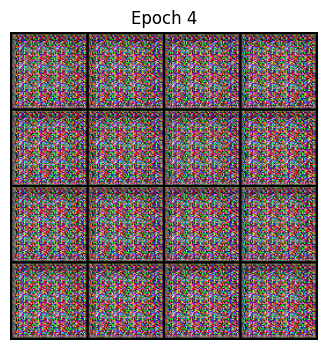

Epoch 5/250: 100%|██████████| 32/32 [02:27<00:00,  4.61s/it, loss_D=0.4080, loss_G=6.0936, inst_sigma=0.0980]


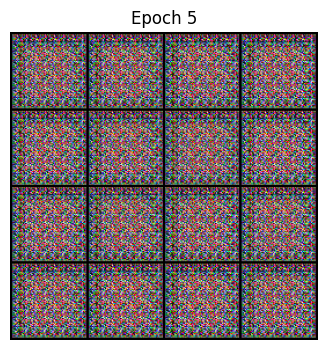

Epoch 6/250: 100%|██████████| 32/32 [02:29<00:00,  4.67s/it, loss_D=0.5544, loss_G=12.7563, inst_sigma=0.0976]


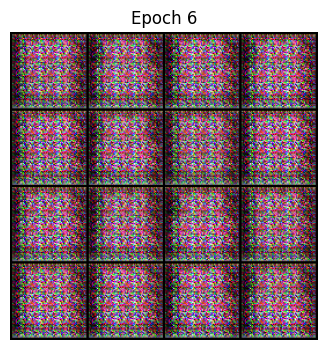

Epoch 7/250: 100%|██████████| 32/32 [02:29<00:00,  4.68s/it, loss_D=0.3795, loss_G=6.0885, inst_sigma=0.0972]


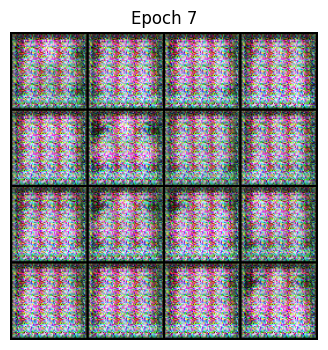

Epoch 8/250: 100%|██████████| 32/32 [02:25<00:00,  4.55s/it, loss_D=0.9635, loss_G=6.7544, inst_sigma=0.0968]


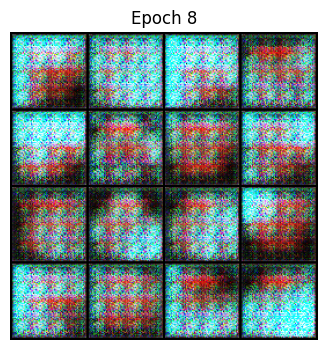

Epoch 9/250: 100%|██████████| 32/32 [02:31<00:00,  4.74s/it, loss_D=0.5058, loss_G=4.6699, inst_sigma=0.0964]


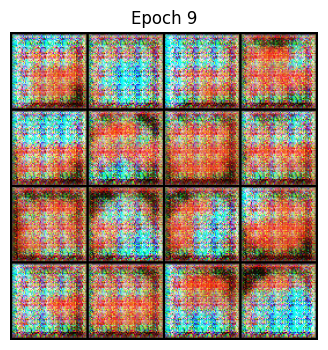

Epoch 10/250: 100%|██████████| 32/32 [02:27<00:00,  4.61s/it, loss_D=0.5845, loss_G=3.8022, inst_sigma=0.0960]


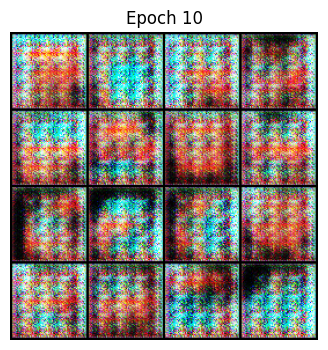

Epoch 11/250: 100%|██████████| 32/32 [02:30<00:00,  4.69s/it, loss_D=0.7300, loss_G=2.9887, inst_sigma=0.0956]


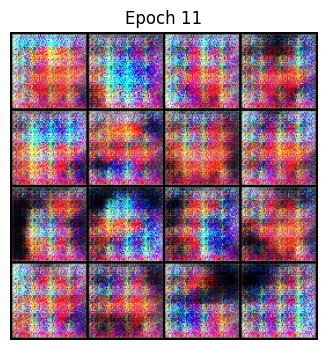

Epoch 12/250: 100%|██████████| 32/32 [02:27<00:00,  4.61s/it, loss_D=1.0610, loss_G=6.0193, inst_sigma=0.0952]


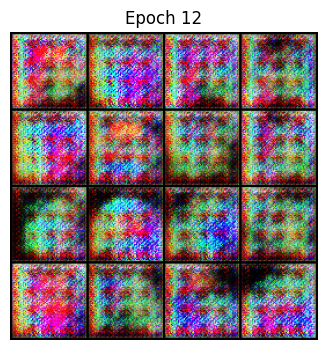

Epoch 13/250: 100%|██████████| 32/32 [02:29<00:00,  4.68s/it, loss_D=0.8388, loss_G=2.7375, inst_sigma=0.0948]


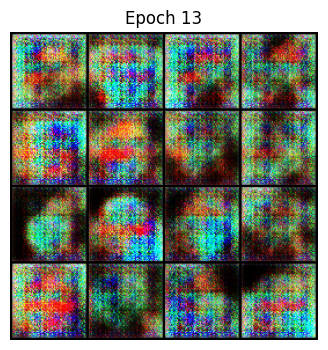

Epoch 14/250: 100%|██████████| 32/32 [02:28<00:00,  4.64s/it, loss_D=0.8269, loss_G=3.7270, inst_sigma=0.0944]


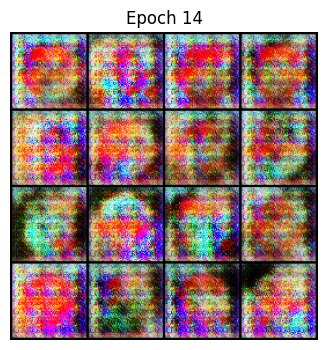

Epoch 15/250: 100%|██████████| 32/32 [02:32<00:00,  4.77s/it, loss_D=0.5010, loss_G=3.8221, inst_sigma=0.0940]


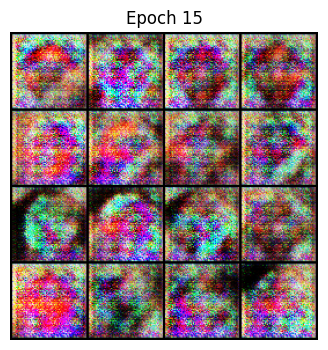

Epoch 16/250: 100%|██████████| 32/32 [02:30<00:00,  4.70s/it, loss_D=0.5852, loss_G=4.2168, inst_sigma=0.0936]


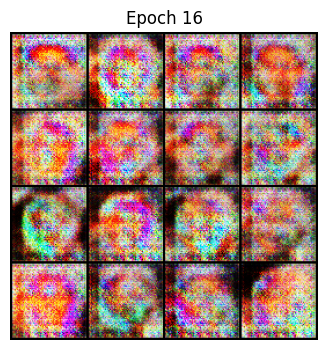

Epoch 17/250: 100%|██████████| 32/32 [02:28<00:00,  4.64s/it, loss_D=0.7246, loss_G=3.6035, inst_sigma=0.0932]


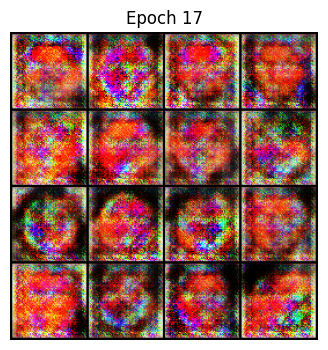

Epoch 18/250: 100%|██████████| 32/32 [02:31<00:00,  4.73s/it, loss_D=0.5114, loss_G=3.5942, inst_sigma=0.0928]


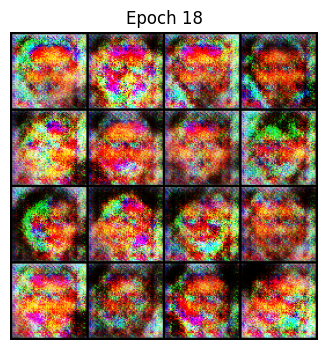

Epoch 19/250: 100%|██████████| 32/32 [02:29<00:00,  4.68s/it, loss_D=1.0793, loss_G=4.1880, inst_sigma=0.0924]


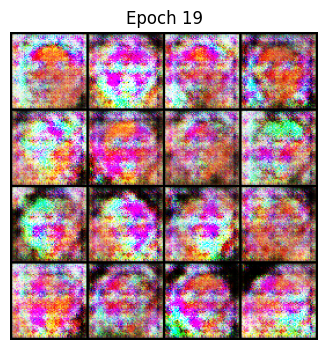

Epoch 20/250: 100%|██████████| 32/32 [02:31<00:00,  4.73s/it, loss_D=0.7282, loss_G=4.6564, inst_sigma=0.0920]


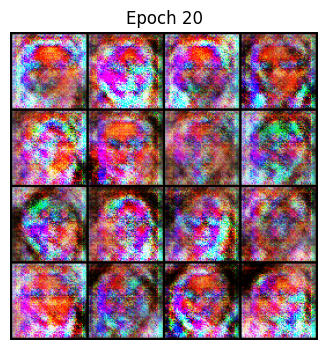

Epoch 21/250: 100%|██████████| 32/32 [02:31<00:00,  4.73s/it, loss_D=0.8590, loss_G=4.7965, inst_sigma=0.0916]


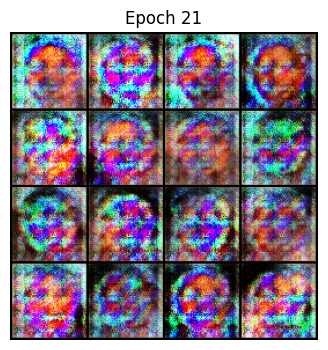

Epoch 22/250: 100%|██████████| 32/32 [02:35<00:00,  4.85s/it, loss_D=0.5971, loss_G=2.3899, inst_sigma=0.0912]


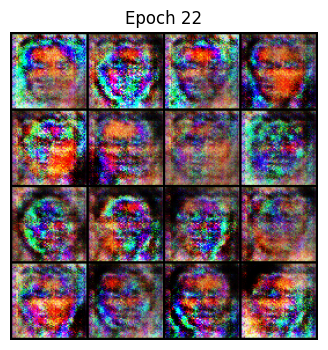

Epoch 23/250: 100%|██████████| 32/32 [02:34<00:00,  4.83s/it, loss_D=0.8368, loss_G=4.9653, inst_sigma=0.0908]


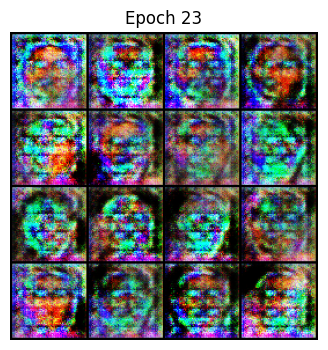

Epoch 24/250: 100%|██████████| 32/32 [02:35<00:00,  4.87s/it, loss_D=0.5969, loss_G=3.4529, inst_sigma=0.0904]


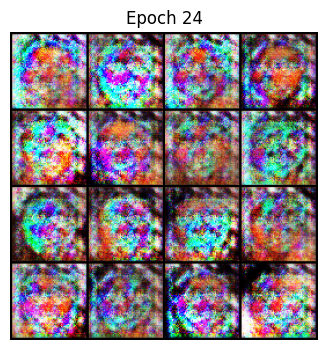

Epoch 25/250: 100%|██████████| 32/32 [02:34<00:00,  4.82s/it, loss_D=0.6306, loss_G=3.7057, inst_sigma=0.0900]


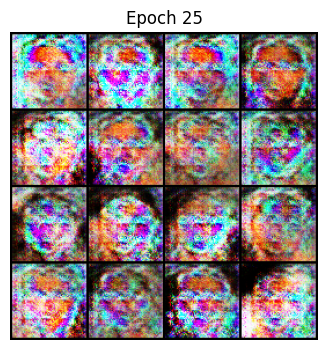

Epoch 26/250: 100%|██████████| 32/32 [02:27<00:00,  4.62s/it, loss_D=0.7398, loss_G=3.4034, inst_sigma=0.0896]


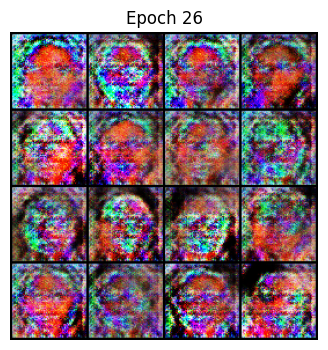

Epoch 27/250: 100%|██████████| 32/32 [02:27<00:00,  4.62s/it, loss_D=0.6716, loss_G=2.8641, inst_sigma=0.0892]


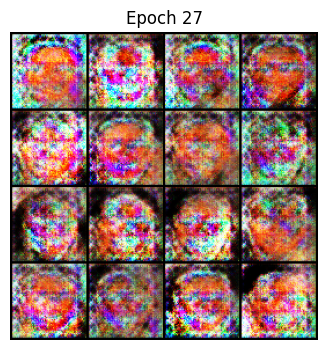

Epoch 28/250: 100%|██████████| 32/32 [02:29<00:00,  4.66s/it, loss_D=0.6478, loss_G=4.4090, inst_sigma=0.0888]


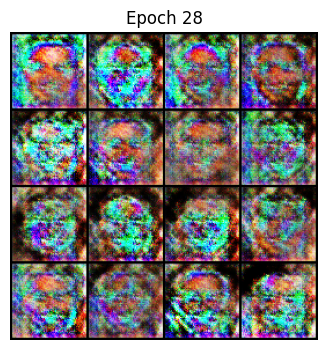

Epoch 29/250: 100%|██████████| 32/32 [02:32<00:00,  4.78s/it, loss_D=0.6546, loss_G=4.7788, inst_sigma=0.0884]


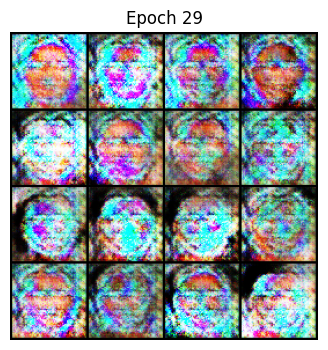

Epoch 30/250: 100%|██████████| 32/32 [02:31<00:00,  4.75s/it, loss_D=0.7739, loss_G=2.8026, inst_sigma=0.0880]


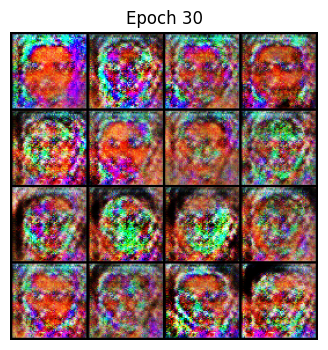

Epoch 31/250: 100%|██████████| 32/32 [02:34<00:00,  4.82s/it, loss_D=0.6429, loss_G=3.0829, inst_sigma=0.0876]


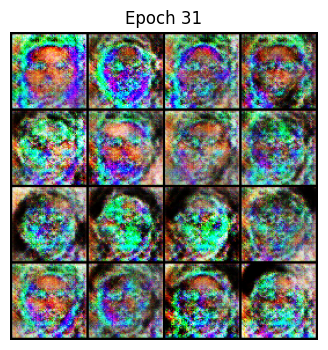

Epoch 32/250: 100%|██████████| 32/32 [02:30<00:00,  4.69s/it, loss_D=0.5716, loss_G=4.1720, inst_sigma=0.0872]


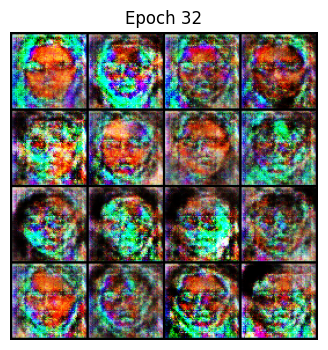

Epoch 33/250: 100%|██████████| 32/32 [02:30<00:00,  4.72s/it, loss_D=0.6732, loss_G=4.3818, inst_sigma=0.0868]


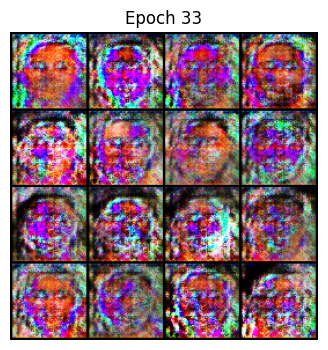

Epoch 34/250: 100%|██████████| 32/32 [02:32<00:00,  4.76s/it, loss_D=0.8541, loss_G=4.6534, inst_sigma=0.0864]


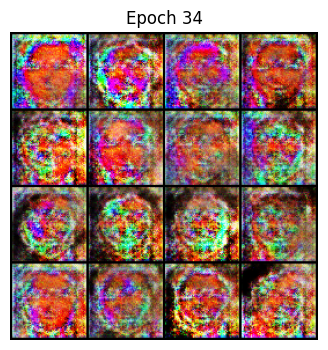

Epoch 35/250: 100%|██████████| 32/32 [02:31<00:00,  4.74s/it, loss_D=0.7700, loss_G=4.3818, inst_sigma=0.0860]


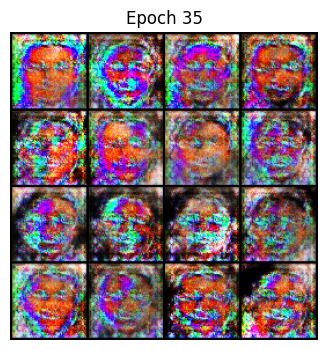

Epoch 36/250: 100%|██████████| 32/32 [02:33<00:00,  4.80s/it, loss_D=0.4576, loss_G=4.4426, inst_sigma=0.0856]


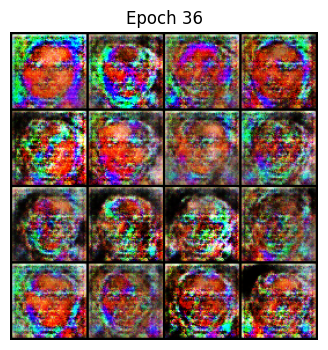

Epoch 37/250: 100%|██████████| 32/32 [02:32<00:00,  4.77s/it, loss_D=0.7976, loss_G=4.9126, inst_sigma=0.0852]


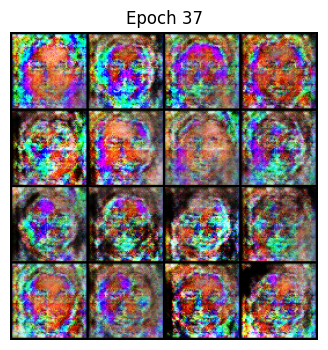

Epoch 38/250: 100%|██████████| 32/32 [02:33<00:00,  4.79s/it, loss_D=0.7116, loss_G=4.2790, inst_sigma=0.0848]


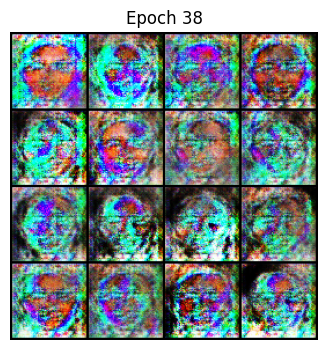

Epoch 39/250: 100%|██████████| 32/32 [02:28<00:00,  4.64s/it, loss_D=0.5326, loss_G=3.7281, inst_sigma=0.0844]


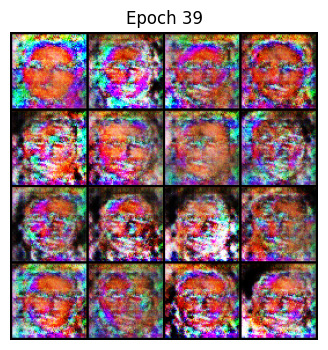

Epoch 40/250: 100%|██████████| 32/32 [02:31<00:00,  4.75s/it, loss_D=0.6169, loss_G=3.7606, inst_sigma=0.0840]


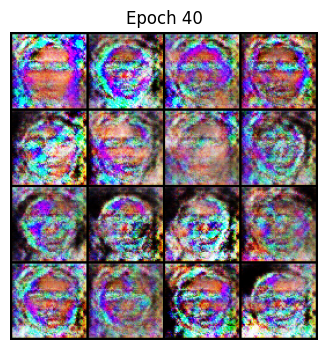

Epoch 41/250: 100%|██████████| 32/32 [02:30<00:00,  4.72s/it, loss_D=0.6847, loss_G=3.0935, inst_sigma=0.0836]


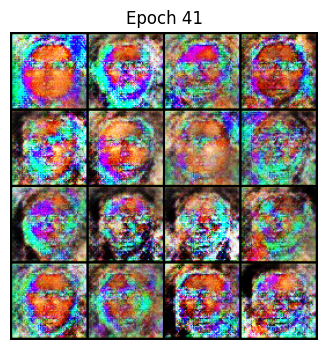

Epoch 42/250: 100%|██████████| 32/32 [02:34<00:00,  4.83s/it, loss_D=0.6116, loss_G=4.9100, inst_sigma=0.0832]


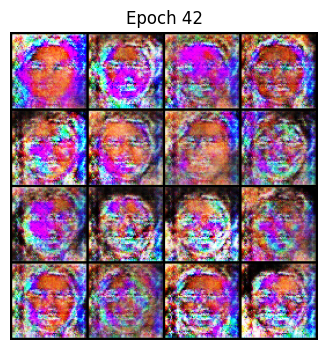

Epoch 43/250: 100%|██████████| 32/32 [02:37<00:00,  4.91s/it, loss_D=0.5727, loss_G=3.9670, inst_sigma=0.0828]


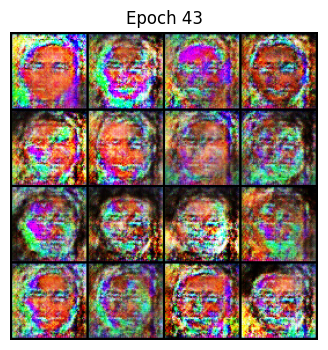

Epoch 44/250: 100%|██████████| 32/32 [02:39<00:00,  4.99s/it, loss_D=0.6908, loss_G=4.2907, inst_sigma=0.0824]


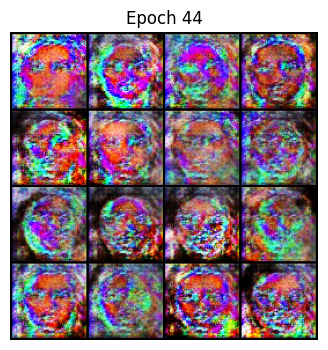

Epoch 45/250: 100%|██████████| 32/32 [02:37<00:00,  4.92s/it, loss_D=0.6243, loss_G=4.3227, inst_sigma=0.0820]


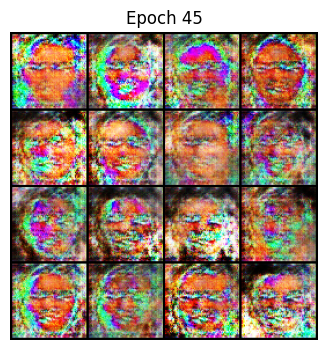

Epoch 46/250: 100%|██████████| 32/32 [02:35<00:00,  4.85s/it, loss_D=0.5365, loss_G=3.8859, inst_sigma=0.0816]


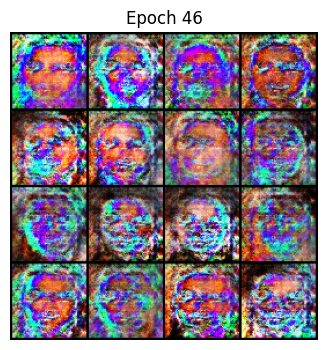

Epoch 47/250: 100%|██████████| 32/32 [02:37<00:00,  4.91s/it, loss_D=0.7219, loss_G=5.4783, inst_sigma=0.0812]


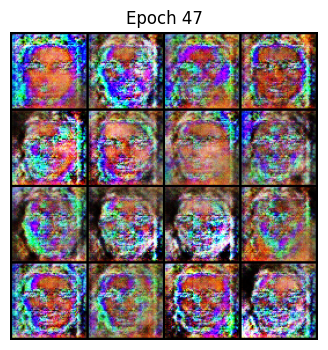

Epoch 48/250: 100%|██████████| 32/32 [02:33<00:00,  4.80s/it, loss_D=0.6571, loss_G=2.8967, inst_sigma=0.0808]


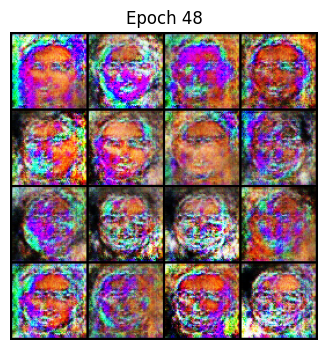

Epoch 49/250: 100%|██████████| 32/32 [02:34<00:00,  4.82s/it, loss_D=0.5391, loss_G=3.1422, inst_sigma=0.0804]


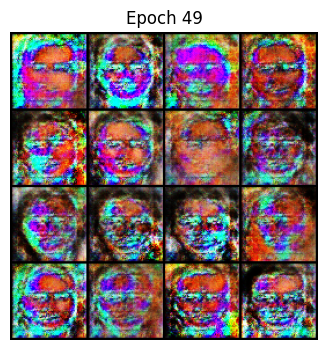

Epoch 50/250: 100%|██████████| 32/32 [02:37<00:00,  4.92s/it, loss_D=0.4426, loss_G=3.8640, inst_sigma=0.0800]


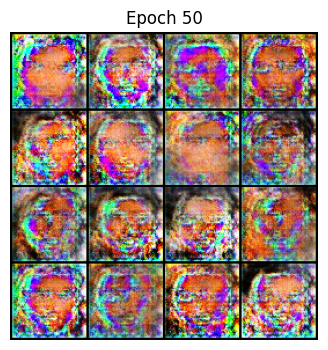

Epoch 51/250: 100%|██████████| 32/32 [02:47<00:00,  5.23s/it, loss_D=0.5957, loss_G=3.9927, inst_sigma=0.0796]


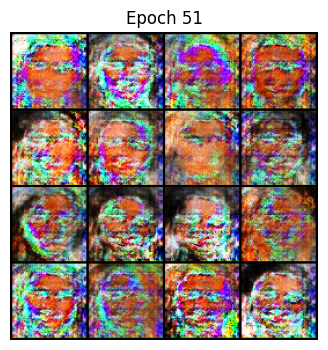

Epoch 52/250: 100%|██████████| 32/32 [02:40<00:00,  5.00s/it, loss_D=0.5662, loss_G=4.3674, inst_sigma=0.0792]


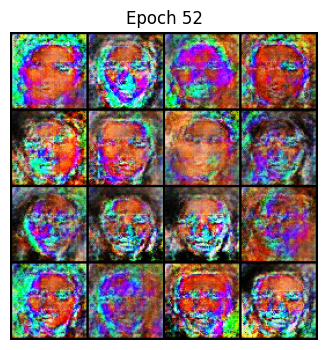

Epoch 53/250: 100%|██████████| 32/32 [02:51<00:00,  5.36s/it, loss_D=0.5061, loss_G=3.6625, inst_sigma=0.0788]


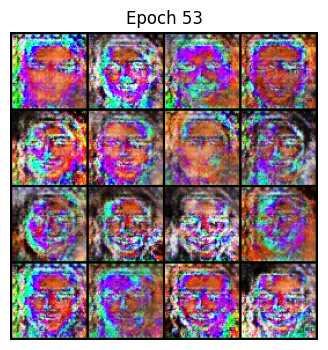

Epoch 54/250: 100%|██████████| 32/32 [02:48<00:00,  5.27s/it, loss_D=0.6267, loss_G=2.5142, inst_sigma=0.0784]


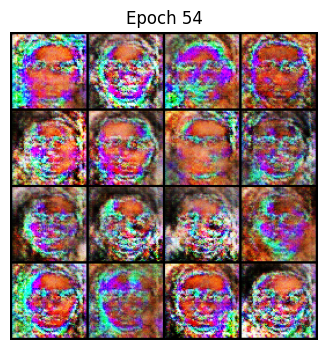

Epoch 55/250: 100%|██████████| 32/32 [03:02<00:00,  5.69s/it, loss_D=0.5472, loss_G=3.0615, inst_sigma=0.0780]


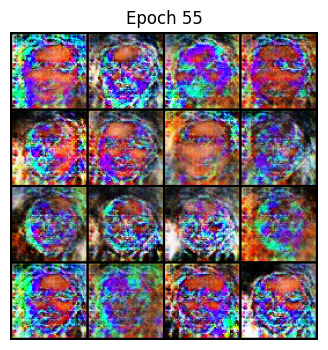

Epoch 56/250: 100%|██████████| 32/32 [02:43<00:00,  5.12s/it, loss_D=0.4608, loss_G=3.0894, inst_sigma=0.0776]


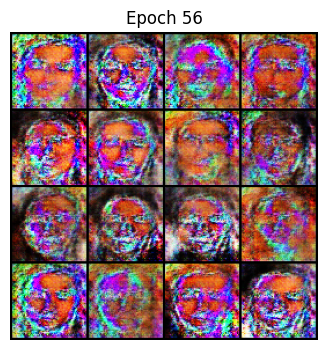

Epoch 57/250: 100%|██████████| 32/32 [02:55<00:00,  5.49s/it, loss_D=0.4680, loss_G=3.7831, inst_sigma=0.0772]


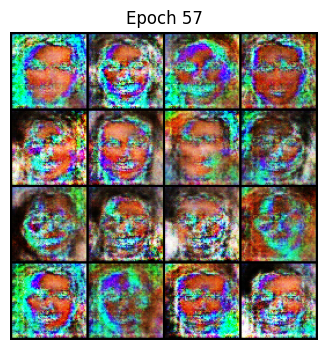

Epoch 58/250: 100%|██████████| 32/32 [03:16<00:00,  6.14s/it, loss_D=0.4915, loss_G=3.1512, inst_sigma=0.0768]


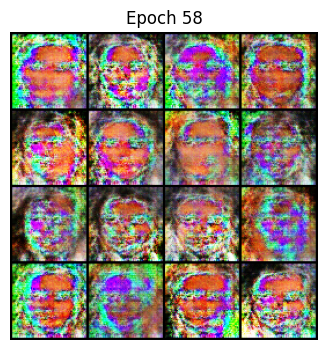

Epoch 59/250: 100%|██████████| 32/32 [02:46<00:00,  5.22s/it, loss_D=0.5752, loss_G=4.3956, inst_sigma=0.0764]


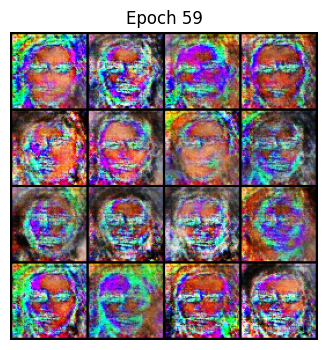

Epoch 60/250: 100%|██████████| 32/32 [02:47<00:00,  5.24s/it, loss_D=0.4916, loss_G=3.0561, inst_sigma=0.0760]


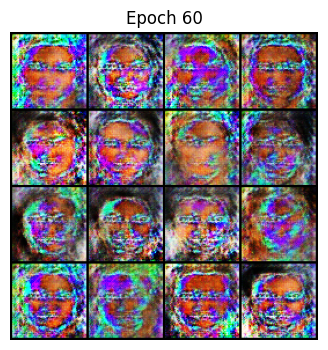

Epoch 61/250: 100%|██████████| 32/32 [03:14<00:00,  6.08s/it, loss_D=0.5428, loss_G=3.7349, inst_sigma=0.0756]


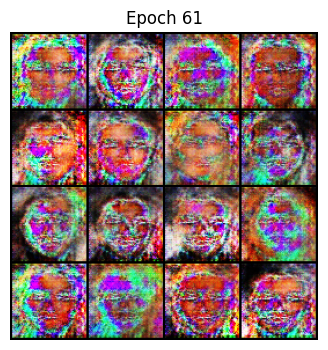

Epoch 62/250: 100%|██████████| 32/32 [02:46<00:00,  5.21s/it, loss_D=0.4706, loss_G=3.2818, inst_sigma=0.0752]


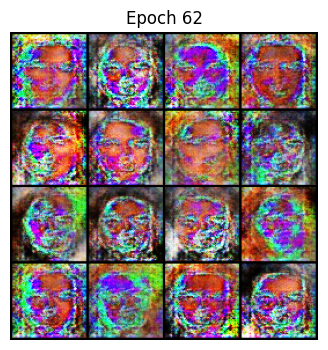

Epoch 63/250: 100%|██████████| 32/32 [03:08<00:00,  5.88s/it, loss_D=0.4437, loss_G=4.0278, inst_sigma=0.0748]


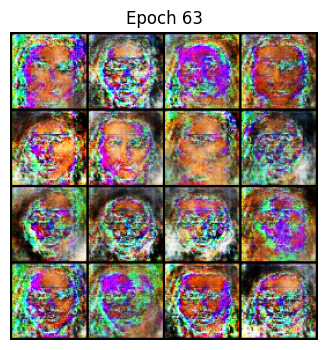

Epoch 64/250: 100%|██████████| 32/32 [02:43<00:00,  5.12s/it, loss_D=0.5134, loss_G=3.7574, inst_sigma=0.0744]


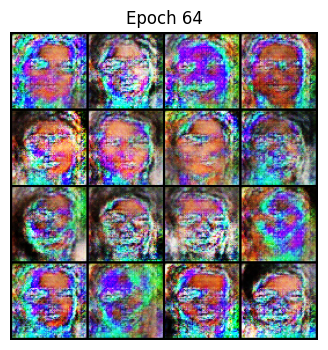

Epoch 65/250: 100%|██████████| 32/32 [02:44<00:00,  5.14s/it, loss_D=0.3987, loss_G=3.8485, inst_sigma=0.0740]


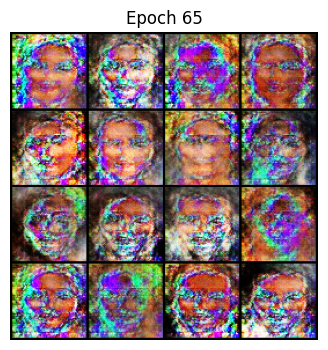

Epoch 66/250: 100%|██████████| 32/32 [02:53<00:00,  5.42s/it, loss_D=0.4450, loss_G=3.2979, inst_sigma=0.0736]


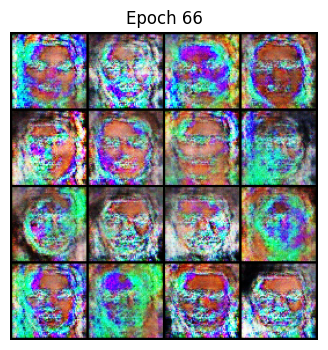

Epoch 67/250: 100%|██████████| 32/32 [02:47<00:00,  5.22s/it, loss_D=0.5351, loss_G=4.2676, inst_sigma=0.0732]


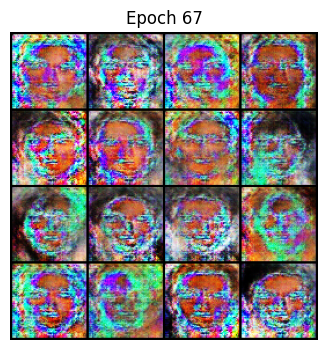

Epoch 68/250: 100%|██████████| 32/32 [02:45<00:00,  5.16s/it, loss_D=0.4888, loss_G=2.7113, inst_sigma=0.0728]


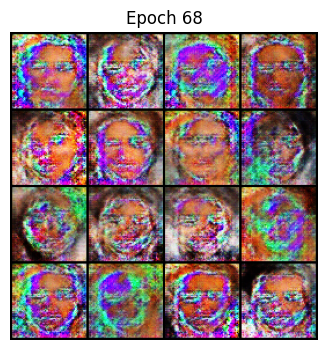

Epoch 69/250: 100%|██████████| 32/32 [03:10<00:00,  5.95s/it, loss_D=0.5183, loss_G=3.6869, inst_sigma=0.0724]


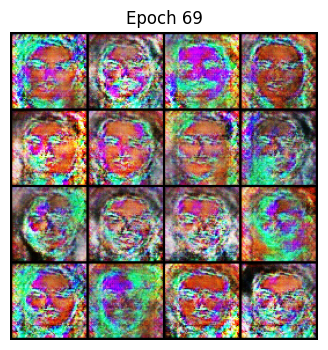

Epoch 70/250: 100%|██████████| 32/32 [02:48<00:00,  5.25s/it, loss_D=0.5374, loss_G=3.3070, inst_sigma=0.0720]


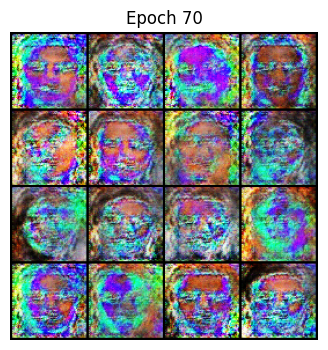

Epoch 71/250: 100%|██████████| 32/32 [02:47<00:00,  5.23s/it, loss_D=0.4856, loss_G=4.1569, inst_sigma=0.0716]


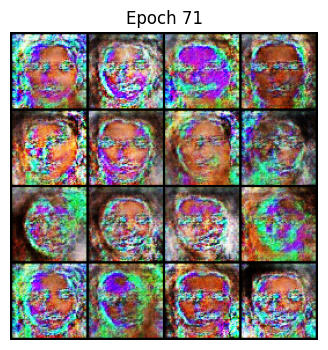

Epoch 72/250: 100%|██████████| 32/32 [03:14<00:00,  6.06s/it, loss_D=0.4435, loss_G=3.6109, inst_sigma=0.0712]


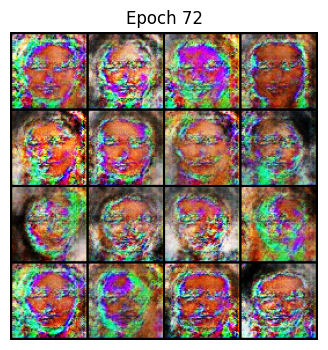

Epoch 73/250: 100%|██████████| 32/32 [03:19<00:00,  6.25s/it, loss_D=0.4345, loss_G=2.7797, inst_sigma=0.0708]


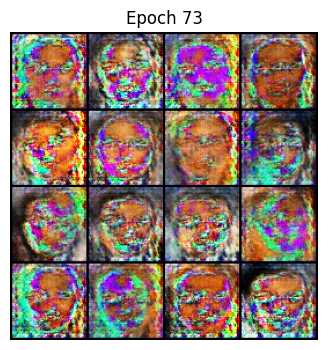

Epoch 74/250: 100%|██████████| 32/32 [03:01<00:00,  5.66s/it, loss_D=0.7499, loss_G=6.0124, inst_sigma=0.0704]


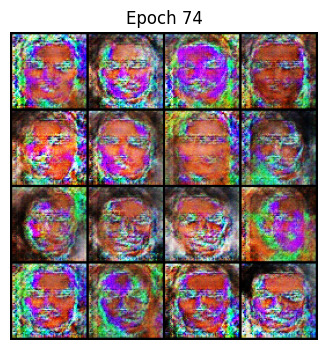

Epoch 75/250: 100%|██████████| 32/32 [03:08<00:00,  5.89s/it, loss_D=0.5355, loss_G=3.4721, inst_sigma=0.0700]


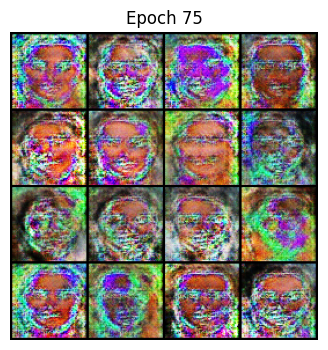

Epoch 76/250: 100%|██████████| 32/32 [02:57<00:00,  5.55s/it, loss_D=0.4633, loss_G=3.6126, inst_sigma=0.0696]


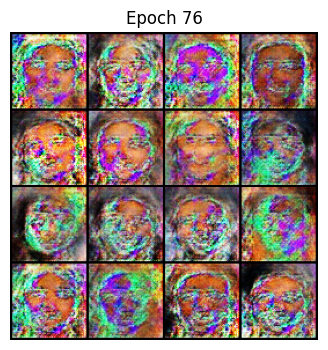

Epoch 77/250: 100%|██████████| 32/32 [02:53<00:00,  5.43s/it, loss_D=0.4672, loss_G=3.3811, inst_sigma=0.0692]


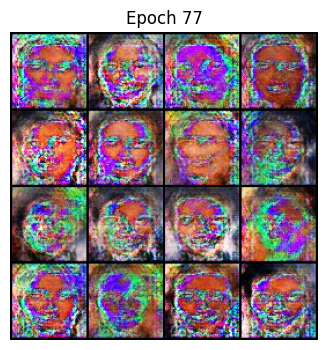

Epoch 78/250:  56%|█████▋    | 18/32 [01:44<01:09,  4.98s/it, loss_D=0.5287, loss_G=3.2879, inst_sigma=0.0688]

In [ ]:
# Full improved DCGAN-style training pipeline for small face dataset (Colab-ready)
import os
import random
import math
from pathlib import Path
from tqdm import tqdm

import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms, utils
from PIL import Image
import matplotlib.pyplot as plt

# ---- Optional: install facenet-pytorch for face alignment ----
# !pip install facenet-pytorch
from facenet_pytorch import MTCNN

# ---------------- CONFIG ----------------
DATA_PATH = "/content/drive/MyDrive/Celebrity faces"          # original folder (folders per celeb)
ALIGNED_PATH = "/content/drive/MyDrive/Celebrity_faces_aligned"  # where aligned crops will be saved
IMG_SIZE = 64
BATCH_SIZE = 16
Z_DIM = 256
EPOCHS = 250
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
SEED = 42
SAVE_DIR = "/content/drive/MyDrive/gan_checkpoints"
SAMPLE_DIR = "/content/drive/MyDrive/gan_samples"
WORKERS = 2
# TTUR learning rates
LR_G = 2e-4
LR_D = 5e-5
BETA1, BETA2 = 0.5, 0.999
# label smoothing
REAL_LABEL_SMOOTH = 0.9
FAKE_LABEL = 0.0
# instance noise schedule
INITIAL_INSTANCE_NOISE = 0.1
FINAL_INSTANCE_NOISE = 0.0
# ----------------------------------------

os.makedirs(ALIGNED_PATH, exist_ok=True)
os.makedirs(SAVE_DIR, exist_ok=True)
os.makedirs(SAMPLE_DIR, exist_ok=True)

random.seed(SEED)
torch.manual_seed(SEED)

# --------- Step 1: One-time face alignment + saving aligned crops ----------
# If aligned directory already contains images, skip processing.
def preprocess_align_faces(src_root, dst_root, img_size=IMG_SIZE, overwrite=False):
    src_root = Path(src_root)
    dst_root = Path(dst_root)
    mtcnn = MTCNN(image_size=img_size, margin=16, post_process=True, select_largest=True, device=str(DEVICE))
    # walk through subfolders and save aligned face crops into dst_root/<class>/
    for class_dir in src_root.iterdir():
        if not class_dir.is_dir(): continue
        out_class = dst_root / class_dir.name
        out_class.mkdir(parents=True, exist_ok=True)
        for img_path in class_dir.iterdir():
            if not img_path.is_file(): continue
            out_path = out_class / img_path.name
            if out_path.exists() and not overwrite:
                continue
            try:
                img = Image.open(img_path).convert('RGB')
                face = mtcnn(img)
                if face is None:
                    # skip if no face detected
                    continue
                # MTCNN returns a torch.Tensor [3,H,W] (already resized)
                # convert to PIL and save
                face_pil = transforms.ToPILImage()(face)
                face_pil.save(out_path)
            except Exception as e:
                # skip problematic images
                print(f"Skipping {img_path}: {e}")

# Run preprocessing (will skip if ALIGNED_PATH already has files)
print("Starting face alignment (this may take a while the first time)...")
preprocess_align_faces(DATA_PATH, ALIGNED_PATH, img_size=IMG_SIZE)
print("Face alignment finished / skipped if already processed.")

# --------- Dataset and DataLoader ----------
augment = transforms.Compose([
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ColorJitter(brightness=0.15, contrast=0.15, saturation=0.15, hue=0.02),
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize([0.5,0.5,0.5], [0.5,0.5,0.5])
])

from torchvision.datasets import ImageFolder
dataset = ImageFolder(root=ALIGNED_PATH, transform=augment)
loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=WORKERS, pin_memory=True)

print(f"Aligned dataset size: {len(dataset)} images, classes: {dataset.classes}")

# --------- Models (DCGAN-like with spectral norm in D) ----------
def convtranspose_block(in_c, out_c, kernel_size, stride, padding, bias=False):
    return nn.Sequential(
        nn.ConvTranspose2d(in_c, out_c, kernel_size, stride, padding, bias=bias),
        nn.BatchNorm2d(out_c),
        nn.ReLU(True)
    )

class Generator(nn.Module):
    def __init__(self, z_dim=Z_DIM, img_channels=3, base=512):
        super().__init__()
        self.net = nn.Sequential(
            # z -> 4x4
            nn.ConvTranspose2d(z_dim, base, 4, 1, 0, bias=False),
            nn.BatchNorm2d(base),
            nn.ReLU(True),
            # 8x8
            nn.ConvTranspose2d(base, base//2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(base//2),
            nn.ReLU(True),
            # 16x16
            nn.ConvTranspose2d(base//2, base//4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(base//4),
            nn.ReLU(True),
            # 32x32
            nn.ConvTranspose2d(base//4, base//8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(base//8),
            nn.ReLU(True),
            # 64x64
            nn.ConvTranspose2d(base//8, img_channels, 4, 2, 1, bias=False),
            nn.Tanh()
        )
    def forward(self, z):
        return self.net(z)

class Discriminator(nn.Module):
    def __init__(self, img_channels=3, base=128):
        super().__init__()
        # use spectral_norm for convs to stabilize discriminator
        def conv_sn(in_c, out_c, k, s, p, bias=False):
            return nn.Sequential(
                nn.utils.spectral_norm(nn.Conv2d(in_c, out_c, k, s, p, bias=bias)),
                nn.LeakyReLU(0.2, inplace=True)
            )
        self.net = nn.Sequential(
            conv_sn(img_channels, base, 4, 2, 1),        # 32x32
            conv_sn(base, base*2, 4, 2, 1),              # 16x16
            nn.BatchNorm2d(base*2),
            nn.LeakyReLU(0.2, inplace=True),
            conv_sn(base*2, base*4, 4, 2, 1),            # 8x8
            nn.BatchNorm2d(base*4),
            nn.LeakyReLU(0.2, inplace=True),
            conv_sn(base*4, base*8, 4, 2, 1),            # 4x4
            nn.Conv2d(base*8, 1, 4, 1, 0, bias=False),  # 1x1
            nn.Sigmoid()
        )
    def forward(self, x):
        return self.net(x).view(-1)

# instantiate
G = Generator(z_dim=Z_DIM).to(DEVICE)
D = Discriminator().to(DEVICE)
print("Model sizes - G params: {:.2f}M D params: {:.2f}M".format(
    sum(p.numel() for p in G.parameters())/1e6,
    sum(p.numel() for p in D.parameters())/1e6
))

# --------- Optimizers and loss ----------
criterion = nn.BCELoss()
opt_G = torch.optim.Adam(G.parameters(), lr=LR_G, betas=(BETA1, BETA2))
opt_D = torch.optim.Adam(D.parameters(), lr=LR_D, betas=(BETA1, BETA2))

# fixed noise for monitoring
fixed_noise = torch.randn(16, Z_DIM, 1, 1, device=DEVICE)

# helper: save sample grid
def save_sample(epoch, step, netG, out_dir=SAMPLE_DIR, nrow=4):
    netG.eval()
    with torch.no_grad():
        imgs = netG(fixed_noise).cpu()
    grid = utils.make_grid(imgs, nrow=nrow, normalize=True)
    out_path = os.path.join(out_dir, f"epoch{epoch:03d}_step{step:05d}.png")
    utils.save_image(grid, out_path)
    netG.train()

# instance noise schedule
def instance_noise_sigma(epoch, max_epochs=EPOCHS, start=INITIAL_INSTANCE_NOISE, end=FINAL_INSTANCE_NOISE):
    # linear decay
    return start + (end - start) * (epoch / max_epochs)

# training loop
global_step = 0
for epoch in range(1, EPOCHS+1):
    pbar = tqdm(loader, desc=f"Epoch {epoch}/{EPOCHS}")
    inst_sigma = instance_noise_sigma(epoch)
    for i, (real_imgs, _) in enumerate(pbar):
        real_imgs = real_imgs.to(DEVICE)
        b_size = real_imgs.size(0)

        # add instance noise (gaussian) to both real and fake, scaled by sigma
        if inst_sigma > 0:
            real_imgs_noisy = real_imgs + torch.randn_like(real_imgs) * inst_sigma
        else:
            real_imgs_noisy = real_imgs

        # --- Train Discriminator ---
        # real labels: use label smoothing
        real_labels = torch.full((b_size,), REAL_LABEL_SMOOTH, device=DEVICE)
        fake_labels = torch.full((b_size,), FAKE_LABEL, device=DEVICE)

        D.zero_grad()
        out_real = D(real_imgs_noisy)
        loss_D_real = criterion(out_real, real_labels)

        # fake
        noise = torch.randn(b_size, Z_DIM, 1, 1, device=DEVICE)
        fake_imgs = G(noise)
        # add instance noise to fake as well
        if inst_sigma > 0:
            fake_imgs_noisy = fake_imgs + torch.randn_like(fake_imgs) * inst_sigma
        else:
            fake_imgs_noisy = fake_imgs

        out_fake = D(fake_imgs_noisy.detach())
        loss_D_fake = criterion(out_fake, fake_labels)

        loss_D = loss_D_real + loss_D_fake
        loss_D.backward()
        opt_D.step()

        # --- Train Generator ---
        G.zero_grad()
        # generator wants D(fake) -> real label (smoothed)
        out_fake_for_G = D(fake_imgs)
        loss_G = criterion(out_fake_for_G, real_labels)  # use smoothed "real" labels for G target
        loss_G.backward()
        opt_G.step()

        global_step += 1
        if global_step % 100 == 0:
            save_sample(epoch, global_step, G)

        pbar.set_postfix({'loss_D': f"{loss_D.item():.4f}", 'loss_G': f"{loss_G.item():.4f}", 'inst_sigma': f"{inst_sigma:.4f}"})

    # end epoch: save checkpoint and sample
    torch.save({
        'epoch': epoch,
        'G_state': G.state_dict(),
        'D_state': D.state_dict(),
        'opt_G': opt_G.state_dict(),
        'opt_D': opt_D.state_dict()
    }, os.path.join(SAVE_DIR, f"checkpoint_epoch{epoch:03d}.pt"))

    save_sample(epoch, global_step, G)
    # display the last sample inline (optional)
    img_path = os.path.join(SAMPLE_DIR, f"epoch{epoch:03d}_step{global_step:05d}.png")
    if os.path.exists(img_path):
        display_img = Image.open(img_path)
        plt.figure(figsize=(4,4))
        plt.axis('off')
        plt.title(f"Epoch {epoch}")
        plt.imshow(display_img)
        plt.show()

print("Training finished. Models and samples saved to Drive.")

# new

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torchvision import datasets, transforms, utils
import matplotlib.pyplot as plt
from IPython.display import display

data_path = "/content/drive/MyDrive/Celebrity faces"

transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.CenterCrop(128),
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5])
])

dataset = datasets.ImageFolder(root=data_path, transform=transform)
loader = DataLoader(dataset, batch_size=32, shuffle=True)
print(len(dataset))

512


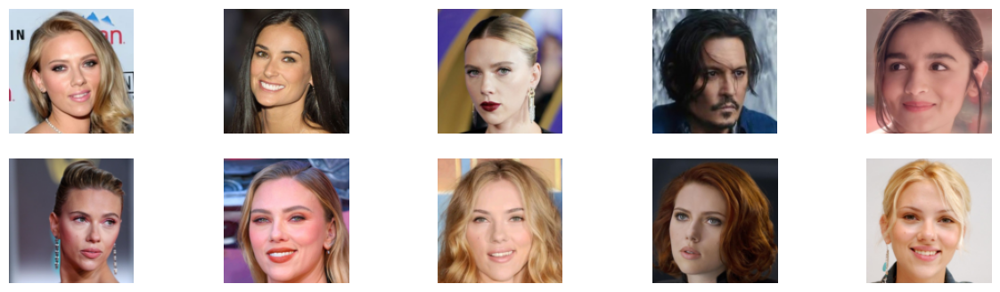

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

images, labels = next(iter(loader))

# Select the first 10
images_10 = images[:10]

# Unnormalize from [-1,1] → [0,1]
def denorm(x):
    return x * 0.5 + 0.5

# Plot
plt.figure(figsize=(15, 4))
for i in range(10):
    img = denorm(images_10[i]).permute(1, 2, 0).numpy()
    plt.subplot(2, 5, i+1)
    plt.imshow(img)
    plt.axis("off")

plt.show()

## ACGAN - (Auxiliary Classifier GAN)

In [ ]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, transforms, utils
from tqdm import tqdm

# ----------------------------
# Hyperparameters
# ----------------------------
IMG_SIZE = 64
Z_DIM = 100
NUM_CLASSES = 6       # change based on your dataset
CHANNELS = 3          # RGB images
BATCH_SIZE = 32
LR = 0.0002
EPOCHS = 200

device = "cuda" if torch.cuda.is_available() else "cpu"

# ----------------------------
# Dataset
# ----------------------------
transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(0.2, 0.2, 0.2, 0.1),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])

def get_loader(path):
    ds = datasets.ImageFolder(path, transform=transform)
    dl = DataLoader(ds, batch_size=BATCH_SIZE, shuffle=True)
    print("Dataset size:", len(ds))
    print("Classes:", ds.classes)
    return dl, len(ds.classes)

# ----------------------------
# Generator
# ----------------------------
class Generator(nn.Module):
    def __init__(self, z_dim, num_classes):
        super().__init__()
        self.label_emb = nn.Embedding(num_classes, num_classes)

        self.model = nn.Sequential(
            nn.Linear(z_dim + num_classes, 512 * 4 * 4),
            nn.BatchNorm1d(512 * 4 * 4),
            nn.ReLU(True)
        )

        self.conv = nn.Sequential(
            nn.ConvTranspose2d(512, 256, 4, 2, 1),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, 4, 2, 1),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(64, CHANNELS, 4, 2, 1),
            nn.Tanh()
        )

    def forward(self, z, labels):
        c = self.label_emb(labels)
        x = torch.cat([z, c], dim=1)
        out = self.model(x)
        out = out.view(z.size(0), 512, 4, 4)
        img = self.conv(out)
        return img

# ----------------------------
# Discriminator
# ----------------------------
class Discriminator(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(CHANNELS, 64, 4, 2, 1),
            nn.LeakyReLU(0.2, True),

            nn.Conv2d(64, 128, 4, 2, 1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, True),

            nn.Conv2d(128, 256, 4, 2, 1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, True),

            nn.Conv2d(256, 512, 4, 2, 1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, True)
        )

        self.adv_layer = nn.Linear(512 * 4 * 4, 1)
        self.cls_layer = nn.Linear(512 * 4 * 4, num_classes)

    def forward(self, img):
        x = self.conv(img)
        x = x.view(x.size(0), -1)
        validity = self.adv_layer(x)
        label = self.cls_layer(x)
        return validity, label

# ----------------------------
# Train ACGAN
# ----------------------------
def train(data_path):
    dataloader, classes = get_loader(data_path)

    G = Generator(Z_DIM, classes).to(device)
    D = Discriminator(classes).to(device)

    adversarial_loss = nn.BCEWithLogitsLoss()
    aux_cls_loss = nn.CrossEntropyLoss()

    opt_G = optim.Adam(G.parameters(), lr=LR, betas=(0.5, 0.999))
    opt_D = optim.Adam(D.parameters(), lr=LR, betas=(0.5, 0.999))

    os.makedirs("acgan_samples", exist_ok=True)

    for epoch in range(EPOCHS):
        pbar = tqdm(dataloader, desc=f"Epoch {epoch+1}/{EPOCHS}")

        for i, (imgs, labels) in enumerate(pbar):
            batch = imgs.size(0)
            real_imgs = imgs.to(device)
            labels = labels.to(device)

            real = torch.ones((batch, 1)).to(device)
            fake = torch.zeros((batch, 1)).to(device)

            # ----------------------------
            # Train Generator
            # ----------------------------
            opt_G.zero_grad()

            z = torch.randn(batch, Z_DIM).to(device)
            gen_labels = torch.randint(0, classes, (batch,)).to(device)

            gen_imgs = G(z, gen_labels)
            validity, pred_label = D(gen_imgs)

            g_loss = \
                adversarial_loss(validity, real) + \
                aux_cls_loss(pred_label, gen_labels)

            g_loss.backward()
            opt_G.step()

            # ----------------------------
            # Train Discriminator
            # ----------------------------
            opt_D.zero_grad()

            # Real
            real_validity, real_pred_label = D(real_imgs)
            d_real_loss = \
                adversarial_loss(real_validity, real) + \
                aux_cls_loss(real_pred_label, labels)

            # Fake
            fake_validity, fake_pred_label = D(gen_imgs.detach())
            d_fake_loss = \
                adversarial_loss(fake_validity, fake) + \
                aux_cls_loss(fake_pred_label, gen_labels)

            d_loss = d_real_loss + d_fake_loss

            d_loss.backward()
            opt_D.step()

            pbar.set_postfix({
                "d_loss": d_loss.item(),
                "g_loss": g_loss.item()
            })

        # Save samples every epoch
        with torch.no_grad():
            z = torch.randn(classes * 5, Z_DIM).to(device)
            sample_labels = torch.arange(classes).repeat_interleave(5).to(device)
            samples = G(z, sample_labels)
            utils.save_image(samples, f"acgan_samples/epoch_{epoch+1}.png",
                             nrow=5, normalize=True)


    print("\nTraining complete!")
    torch.save(G.state_dict(), "acgan_G_final.pth")
    torch.save(D.state_dict(), "acgan_D_final.pth")
# ----------------------------
# Run
# ----------------------------
if __name__ == "__main__":
    data_path = "/content/drive/MyDrive/Celebrity faces"
    train(data_path)


Dataset size: 512
Classes: ['Alia', 'Demi moore', 'Henry cavil', 'Johnny depp', 'Kristien', 'Sakib khan', 'Salman khan', 'Scarlet johansson', 'Shahrukh khan']


Epoch 200/200: 100%|██████████| 16/16 [00:04<00:00,  3.30it/s, d_loss=0.378, g_loss=10.9]


Training complete!


Generator loaded!


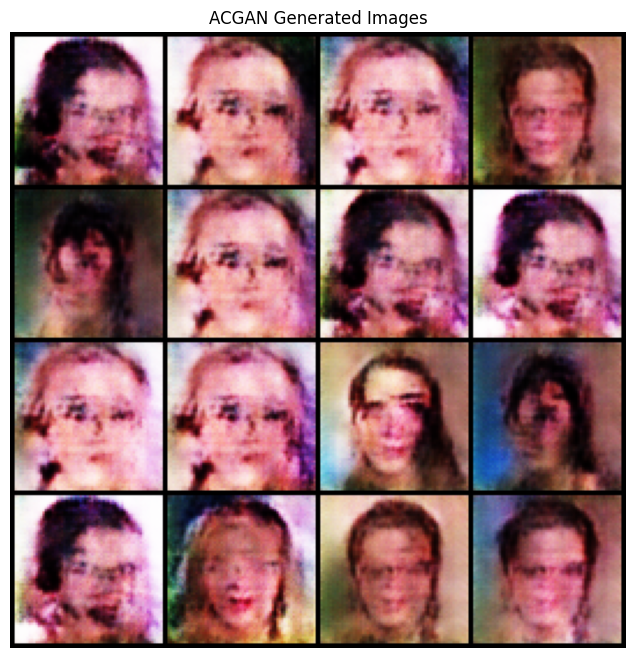

In [ ]:
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
import numpy as np

# ------------------------------
# 1. Define Generator (must match training exactly)
# ------------------------------
class Generator(nn.Module):
    def __init__(self, z_dim, num_classes):
        super().__init__()
        self.label_emb = nn.Embedding(num_classes, num_classes)

        self.model = nn.Sequential(
            nn.Linear(z_dim + num_classes, 512 * 4 * 4),
            nn.BatchNorm1d(512 * 4 * 4),
            nn.ReLU(True)
        )

        self.conv = nn.Sequential(
            nn.ConvTranspose2d(512, 256, 4, 2, 1),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, 4, 2, 1),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(64, 3, 4, 2, 1),
            nn.Tanh()
        )

    def forward(self, z, labels):
        # Embed class labels and concatenate with noise
        c = self.label_emb(labels)
        x = torch.cat([z, c], dim=1)
        out = self.model(x)
        out = out.view(z.size(0), 512, 4, 4)
        img = self.conv(out)
        return img

# ------------------------------
# 2. Load trained generator
# ------------------------------
device = "cuda" if torch.cuda.is_available() else "cpu"

Z_DIM = 100
NUM_CLASSES = 9   # MUST match training
G_PATH = "/content/acgan_G_final.pth"  # path to your saved generator

G = Generator(Z_DIM, NUM_CLASSES).to(device)
G.load_state_dict(torch.load(G_PATH, map_location=device))
G.eval()
print("Generator loaded!")

# ------------------------------
# 3. Generate samples
# ------------------------------
num_samples = 16
z = torch.randn(num_samples, Z_DIM).to(device)
labels = torch.randint(0, NUM_CLASSES, (num_samples,)).to(device)

with torch.no_grad():
    fake_images = G(z, labels).cpu()

# ------------------------------
# 4. Convert to grid and display
# ------------------------------
grid = make_grid(fake_images, nrow=4, normalize=True, value_range=(-1, 1))

plt.figure(figsize=(8, 8))
plt.imshow(np.transpose(grid.numpy(), (1, 2, 0)))
plt.title("ACGAN Generated Images")
plt.axis("off")
plt.show()
